In [ ]:
from collections import Counter, defaultdict
import string
import re
from typing import Tuple, Dict, Any
from time import time, strftime, localtime
import joblib
import os
from os.path import exists


import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from scipy.stats import kruskal
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import RobustScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.tree import DecisionTreeRegressor
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.base import BaseEstimator
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.util import ngrams
import nltk
nltk.download('stopwords')
nltk.download('punkt')


%matplotlib inline
sns.set_theme(style="dark")
mpl.rcParams['axes.unicode_minus'] = False
pd.set_option('display.max_columns',None)
plt.style.use('seaborn-dark-palette')
plt.style.use('dark_background')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
<ipython-input-106-6979eab81b26>:43: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



In [ ]:
from google.colab import files

files.upload()

KeyboardInterrupt: 

In [ ]:
dataFileName = os.path.join( "..", "data", "Airbnb_Open_Data.csv")

data = pd.read_csv(dataFileName, encoding='utf-8')
data.head()

<ipython-input-108-f4069092403e>:1: DtypeWarning:

Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.



,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,US,False,strict,Private room,2020.0,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,US,False,moderate,Entire home/apt,2007.0,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,US,True,flexible,Private room,2005.0,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,US,True,moderate,Entire home/apt,2005.0,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,US,False,moderate,Entire home/apt,2009.0,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",NaN


In [ ]:
data.shape

(102599, 26)

## General Preprocessing

In [ ]:
# Change all column names to have underscore "_" instead of space and to only include lowercase letters
data.rename(columns=lambda x: x.replace(' ', '_'), inplace=True)
data.columns = data.columns.str.lower()

In [ ]:
data.dtypes

id                                  int64
name                               object
host_id                             int64
host_identity_verified             object
host_name                          object
neighbourhood_group                object
neighbourhood                      object
lat                               float64
long                              float64
country                            object
country_code                       object
instant_bookable                   object
cancellation_policy                object
room_type                          object
construction_year                 float64
price                              object
service_fee                        object
minimum_nights                    float64
number_of_reviews                 float64
last_review                        object
reviews_per_month                 float64
review_rate_number                float64
calculated_host_listings_count    float64
availability_365                  

In [ ]:
#Change price & service fee to int number :
data['price'] = pd.to_numeric(data['price'].replace({'\$': '', ',': ''}, regex=True), errors='coerce')
data['service_fee'] = pd.to_numeric(data['service_fee'].replace({'\$': '', ',': ''}, regex=True), errors='coerce')

In [ ]:
#fix neighborhoods
data['neighbourhood_group'] = data['neighbourhood_group'].replace({'brookln': 'Brooklyn', 'manhatan': 'Manhattan'})

In [ ]:
# fix data types
data["id"] = data["id"].astype(str)
data["host_id"] = data["host_id"].astype(str)
data["construction_year"] = pd.to_datetime(data["construction_year"], format='%Y').dt.year
data["last_review"] = pd.to_datetime(data["last_review"])

In [ ]:
# Change all column names to have underscore "_" instead of space
data.rename(columns=lambda x: x.replace(' ', '_'), inplace=True)

In [ ]:
print(data.isna().sum(), "\n")
round(((data.isna().sum()/len(data))*100), 2)

id                                     0
name                                 250
host_id                                0
host_identity_verified               289
host_name                            406
neighbourhood_group                   29
neighbourhood                         16
lat                                    8
long                                   8
country                              532
country_code                         131
instant_bookable                     105
cancellation_policy                   76
room_type                              0
construction_year                    214
price                                247
service_fee                          273
minimum_nights                       409
number_of_reviews                    183
last_review                        15893
reviews_per_month                  15879
review_rate_number                   326
calculated_host_listings_count       319
availability_365                     448
house_rules     

id                                  0.00
name                                0.24
host_id                             0.00
host_identity_verified              0.28
host_name                           0.40
neighbourhood_group                 0.03
neighbourhood                       0.02
lat                                 0.01
long                                0.01
country                             0.52
country_code                        0.13
instant_bookable                    0.10
cancellation_policy                 0.07
room_type                           0.00
construction_year                   0.21
price                               0.24
service_fee                         0.27
minimum_nights                      0.40
number_of_reviews                   0.18
last_review                        15.49
reviews_per_month                  15.48
review_rate_number                  0.32
calculated_host_listings_count      0.31
availability_365                    0.44
house_rules     

In [ ]:
# Drop missing values in price
data = data.dropna(subset=["price"])

# Drop license that is missing all values
data.drop(["license"], axis = 1, inplace = True)

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
lat,102344.0,40.728090,0.055870,40.49979,40.68873,40.72228,40.76276,40.91697
long,102344.0,-73.949647,0.049522,-74.24984,-73.98257,-73.95444,-73.93235,-73.70522
construction_year,102142.0,2012.487038,5.765066,2003.00000,2007.00000,2012.00000,2017.00000,2022.00000
price,102352.0,625.293536,331.671614,50.00000,340.00000,624.00000,913.00000,1200.00000
service_fee,102113.0,125.038399,66.333513,10.00000,68.00000,125.00000,183.00000,240.00000
minimum_nights,101943.0,8.125619,30.556607,-1223.00000,2.00000,3.00000,5.00000,5645.00000
number_of_reviews,102169.0,27.487878,49.521341,0.00000,1.00000,7.00000,30.00000,1024.00000
reviews_per_month,86500.0,1.375068,1.747680,0.01000,0.22000,0.74000,2.01000,90.00000
review_rate_number,102026.0,3.279282,1.284458,1.00000,2.00000,3.00000,4.00000,5.00000
calculated_host_listings_count,102033.0,7.927200,32.211222,1.00000,1.00000,1.00000,2.00000,332.00000


In [ ]:
data.describe(include = "object").T

,count,unique,top,freq
id,102352,101811,6048806,2
name,102105,61135,Home away from home,32
host_id,102352,101810,85335405136,2
host_identity_verified,102067,2,unconfirmed,51087
host_name,101951,13176,Michael,877
neighbourhood_group,102324,5,Manhattan,43683
neighbourhood,102337,224,Bedford-Stuyvesant,7921
country,101825,1,United States,101825
country_code,102226,1,US,102226
instant_bookable,102252,2,False,51354


## *Price, Service Fee & Reviews*

### Price & Service Fee Analysis

In [ ]:
data[["price", "service_fee"]].head()

,price,service_fee
0,966.0,193.0
1,142.0,28.0
2,620.0,124.0
3,368.0,74.0
4,204.0,41.0


In [ ]:
data[["price", "service_fee"]].describe()

,price,service_fee
count,102352.000000,102113.000000
mean,625.293536,125.038399
std,331.671614,66.333513
min,50.000000,10.000000
25%,340.000000,68.000000
50%,624.000000,125.000000
75%,913.000000,183.000000
max,1200.000000,240.000000


In [ ]:
data.isna().sum()

id                                    0
name                                247
host_id                               0
host_identity_verified              285
host_name                           401
neighbourhood_group                  28
neighbourhood                        15
lat                                   8
long                                  8
country                             527
country_code                        126
instant_bookable                    100
cancellation_policy                  71
room_type                             0
construction_year                   210
price                                 0
service_fee                         239
minimum_nights                      409
number_of_reviews                   183
last_review                       15867
reviews_per_month                 15852
review_rate_number                  326
calculated_host_listings_count      319
availability_365                    448
house_rules                       51996


In [ ]:
data = data.loc[data["price"].notna()]
data = data.loc[data["service_fee"].isna()==0]

<ipython-input-124-abe93e838fcc>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



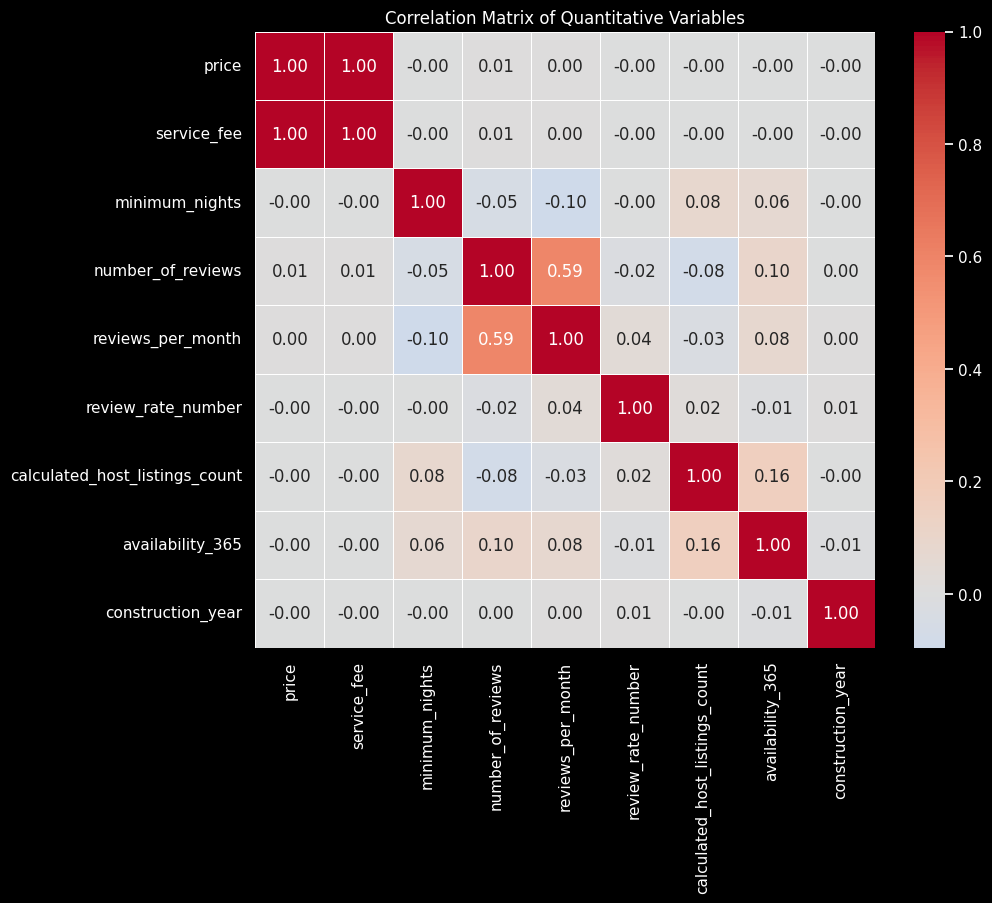

In [ ]:
quantitative_col = ['price', 'service_fee', 'minimum_nights', 'number_of_reviews', 'last_review', 'reviews_per_month', 'review_rate_number', 'calculated_host_listings_count', 'availability_365', 'construction_year']
correlation_matrix = data[quantitative_col].corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix of Quantitative Variables')
plt.show()

The strongest correlation is between price and service fee, where there is a perfect 1:1 relationship. However, all other quantitative variables have close to non-existent correlation, ranging from 0.01 to -0.01.

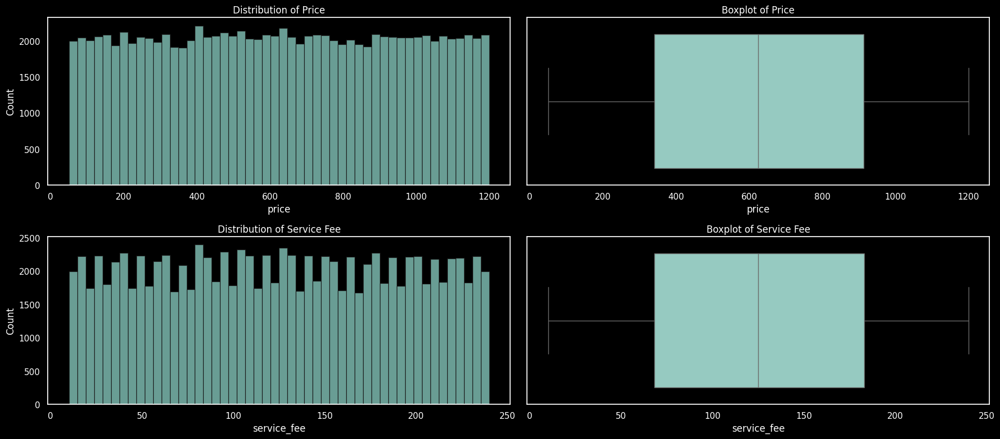

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(18, 8))

sns.histplot(data["price"], bins=50, edgecolor="k", ax=axes[0, 0])
axes[0, 0].set_title("Distribution of Price")

sns.boxplot(x=data["price"], ax=axes[0, 1])
axes[0, 1].set_title("Boxplot of Price")

sns.histplot(data["service_fee"], bins=50, edgecolor="k", ax=axes[1, 0])
axes[1, 0].set_title("Distribution of Service Fee")

sns.boxplot(x=data["service_fee"], ax=axes[1, 1])
axes[1, 1].set_title("Boxplot of Service Fee")

plt.tight_layout()
plt.show()

The range of prices and service fees are equally distributed and do not demonstrate any outliers or strong variance.

#### Price

In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("neighbourhood")])

print("Kruskal-Wallis H-test on Price - Neighbourhood:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Neighbourhood:
H-statistic: 391.0681741564709
p-value: 2.4716164667633007e-11


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("neighbourhood_group")])

print("Kruskal-Wallis H-test on Price - Neighbourhood Group:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Neighbourhood Group:
H-statistic: 6.517528745056742
p-value: 0.16368927585473067


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("host_identity_verified")])

print("Kruskal-Wallis H-test on Price - Host Identity Verified:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Host Identity Verified:
H-statistic: 1.7260596232326215
p-value: 0.18891490333341318


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("instant_bookable")])

print("Kruskal-Wallis H-test on Price - Instant Bookable:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Instant Bookable:
H-statistic: 0.021897213167349716
p-value: 0.8823608646960794


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("construction_year")])

print("Kruskal-Wallis H-test on Price - Construction Year:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Construction Year:
H-statistic: 34.22563362025386
p-value: 0.01728279735273725


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("cancellation_policy")])

print("Kruskal-Wallis H-test on Price - Cancellation Policy:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Cancellation Policy:
H-statistic: 0.5355230514255055
p-value: 0.7650902136926487



The null hypothesis is that the medians of the price distributions are equal across all groups.

Comparing, the test on Price resulted in a very low p-value (significantly below 0.05), indicating that there is a statistically significant difference in the distribution of prices between different neighborhoods. This suggests that at least one neighborhood's median price is significantly different from others. Using a Kruskal-Wallis H-test to test if price has an effect on the qualitative variables, it is discovered that there is a statistically significant difference in the distribution of prices between Neighbourhoods and Construction Year

On the other hand, the test on Neighbourhood Groups, Instant Bookable, Cancellation Policy and Host Identity Verified resulted in a p-value greater than 0.05, which means there is no statistically significant difference in the distribution of prices between the different neighborhood groups and the host being verified or not.

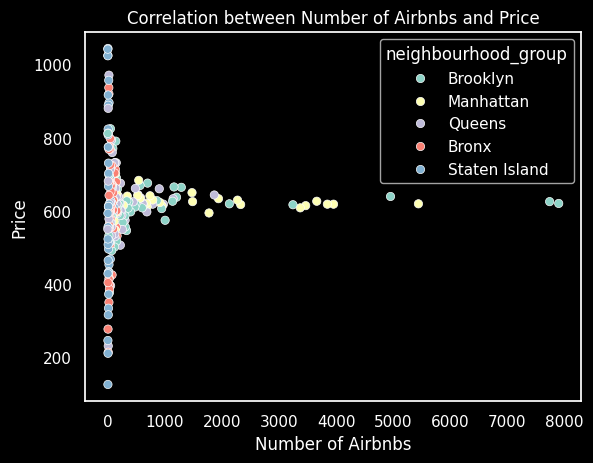

In [ ]:
# Calculate the count of Airbnbs in each neighborhood
neighborhood_counts = data['neighbourhood'].value_counts().reset_index()
neighborhood_counts.columns = ['neighbourhood', 'listing_count']

# Merge the count of Airbnbs with the median price data on 'neighbourhood'
neighborhood_stats = pd.merge(neighborhood_counts, data.groupby('neighbourhood')['price'].median().reset_index(), on='neighbourhood', how='inner')

# Merge the 'neighbourhood group' data with 'neighborhood_stats'
neighborhood_stats = pd.merge(neighborhood_stats, data.groupby('neighbourhood')['neighbourhood_group'].first().reset_index(), on='neighbourhood', how='inner')

# Plot correlation between the count of Airbnbs and median price
sns.scatterplot(data=neighborhood_stats, x='listing_count', y='price', hue='neighbourhood_group')
plt.title('Correlation between Number of Airbnbs and Price')
plt.xlabel('Number of Airbnbs')
plt.ylabel('Price')
plt.show()

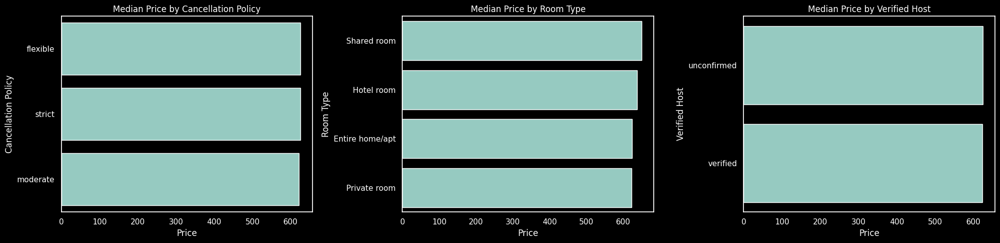

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

# Plot for cancellation policy
data_summary = data.groupby('cancellation_policy')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='cancellation_policy', x='price', ax=axes[0])
axes[0].set_title('Median Price by Cancellation Policy')
axes[0].set_xlabel('Price')
axes[0].set_ylabel('Cancellation Policy')

# Plot for room type
data_summary = data.groupby('room_type')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='room_type', x='price', ax=axes[1])
axes[1].set_title('Median Price by Room Type')
axes[1].set_xlabel('Price')
axes[1].set_ylabel('Room Type')

# Plot for room type
data_summary = data.groupby('host_identity_verified')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='host_identity_verified', x='price', ax=axes[2])
axes[2].set_title('Median Price by Verified Host')
axes[2].set_xlabel('Price')
axes[2].set_ylabel('Verified Host')

plt.tight_layout()
plt.show()

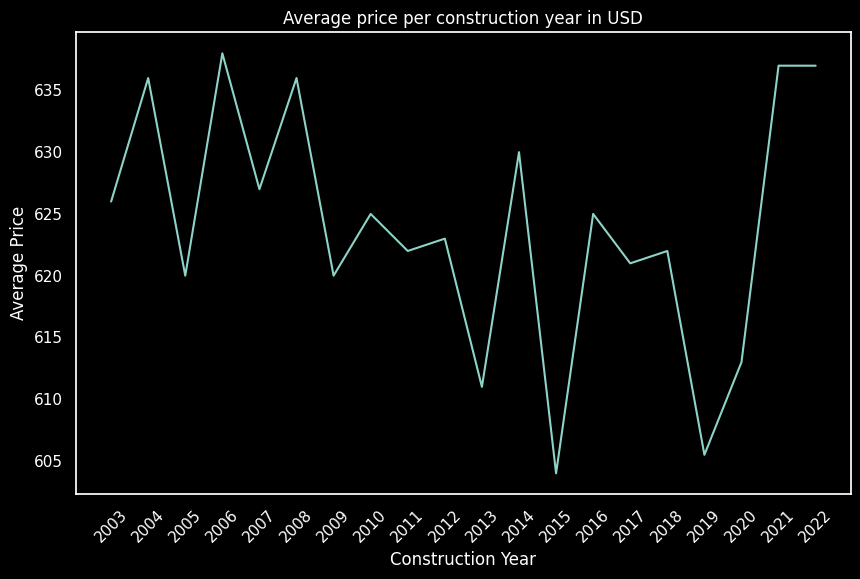

In [ ]:
price_per_year = data.groupby('construction_year')['price'].median().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(data=price_per_year, x="construction_year", y="price")
plt.title("Average price per construction year in USD")
plt.xlabel("Construction Year")
plt.ylabel("Average Price")
plt.xticks(ticks = price_per_year["construction_year"], rotation=45)
plt.show()

Analyzing the impact of the construction year on pricing reveals a fluctuating pattern, indicative of the influence of major external factors. Some examples of significant dips could be e.g. correlated with the periods of the Global Financial Crisis around 2007-2008 and the COVID-19 Pandemic from 2019 onwards. These events evidently played a role in the variability of prices. Despite these fluctuations, the data does not exhibit a clear long-term trend in pricing over the years observed.

#### Service Fee

In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("neighbourhood")])

print("Kruskal-Wallis H-test on Service Fee - Neighbourhood:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Neighbourhood:
H-statistic: 391.1283991683172
p-value: 2.4389933907835417e-11


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("neighbourhood_group")])

print("Kruskal-Wallis H-test on Service Fee - Neighbourhood Group:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Neighbourhood Group:
H-statistic: 6.513084798681317
p-value: 0.16396779998875535


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("host_identity_verified")])

print("Kruskal-Wallis H-test on Service Fee - Host Identity Verified:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Host Identity Verified:
H-statistic: 1.7277534996195976
p-value: 0.18869805084715752


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("construction_year")])

print("Kruskal-Wallis H-test on Service Fee - Construction Year:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Construction Year:
H-statistic: 34.24226686468196
p-value: 0.01720451640476949


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("instant_bookable")])

print("Kruskal-Wallis H-test on Service Fee - Instant Bookable:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Instant Bookable:
H-statistic: 0.021799617458969234
p-value: 0.882621412109964


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("cancellation_policy")])

print("Kruskal-Wallis H-test on Service Fee - Cancellation Policy:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Cancellation Policy:
H-statistic: 0.5401287762165257
p-value: 0.7633303433577125


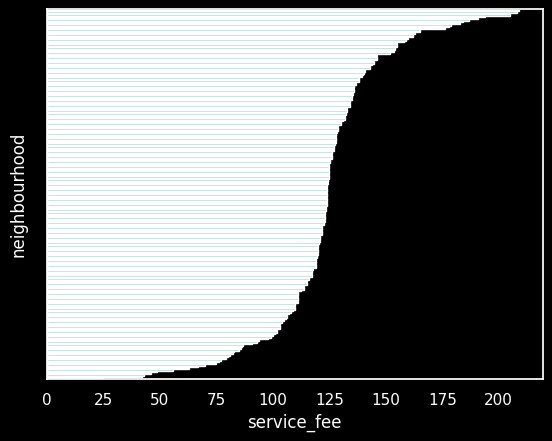

In [ ]:
data_summary = data.groupby('neighbourhood')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='neighbourhood', x='service_fee')
plt.gca().set_yticklabels([])
plt.show()

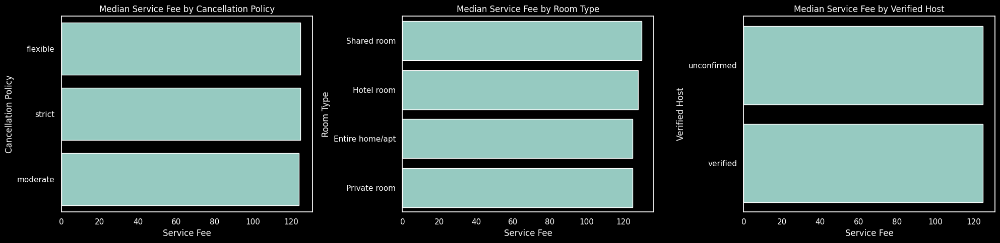

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

# Plot for cancellation policy
data_summary = data.groupby('cancellation_policy')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='cancellation_policy', x='service_fee', ax=axes[0])
axes[0].set_title('Median Service Fee by Cancellation Policy')
axes[0].set_xlabel('Service Fee')
axes[0].set_ylabel('Cancellation Policy')

# Plot for room type
data_summary = data.groupby('room_type')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='room_type', x='service_fee', ax=axes[1])
axes[1].set_title('Median Service Fee by Room Type')
axes[1].set_xlabel('Service Fee')
axes[1].set_ylabel('Room Type')

# Plot for room type
data_summary = data.groupby('host_identity_verified')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='host_identity_verified', x='service_fee', ax=axes[2])
axes[2].set_title('Median Service Fee by Verified Host')
axes[2].set_xlabel('Service Fee')
axes[2].set_ylabel('Verified Host')

plt.tight_layout()
plt.show()

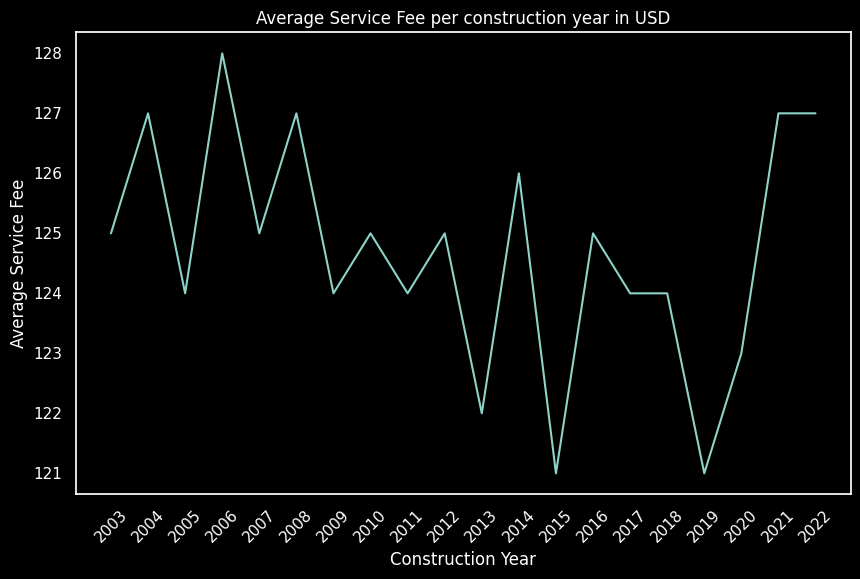

In [ ]:
price_per_year = data.groupby('construction_year')['service_fee'].median().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(data=price_per_year, x="construction_year", y="service_fee")
plt.title("Average Service Fee per construction year in USD")
plt.xlabel("Construction Year")
plt.ylabel("Average Service Fee")
plt.xticks(ticks = price_per_year["construction_year"], rotation=45)
plt.show()

As the correlation plot has foresaw the 1:1 relationship between service fee and price, all the results above are the exact same as for price.

### Review Analysis

In [ ]:
data[["number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]].head()

,number_of_reviews,last_review,reviews_per_month,review_rate_number
0,9.0,2021-10-19,0.21,4.0
1,45.0,2022-05-21,0.38,4.0
2,0.0,NaT,NaN,5.0
3,270.0,2019-07-05,4.64,4.0
4,9.0,2018-11-19,0.10,3.0


In [ ]:
data[["number_of_reviews", "reviews_per_month", "review_rate_number"]].describe()

,number_of_reviews,reviews_per_month,review_rate_number
count,101930.000000,86285.00000,101787.000000
mean,27.495242,1.37567,3.279142
std,49.544249,1.74833,1.284519
min,0.000000,0.01000,1.000000
25%,1.000000,0.22000,2.000000
50%,7.000000,0.74000,3.000000
75%,30.000000,2.01000,4.000000
max,1024.000000,90.00000,5.000000


High Standard Deviation in 'number_of_reviews': The standard deviation for number_of_reviews is quite high at approximately 49.54, indicating a large variability in the number of reviews across different entities.

Zero Minimum Values: There are entities with zero reviews (number_of_reviews) and with reviews per month (reviews_per_month) as low as 0.01. This could be due to new entities just added to the database or entities that are not popular or visible to the reviewers.

Outliers: The max values, especially the 1024 number_of_reviews and 90 reviews_per_month (which is impossible considering there are only 30 days on average in a month), are significantly higher than the 75th percentile values (30 and 2.01 respectively), suggesting the presence of outliers. These outliers could significantly skew the mean, making the data distribution highly skewed.

Mean vs. Median: For all three columns (number_of_reviews, reviews_per_month, and review_rate_number), the mean is higher than the median (50% percentile), which is an indication that the data is right-skewed, meaning there are some very high values pulling the mean up.

#### Number of Reviews

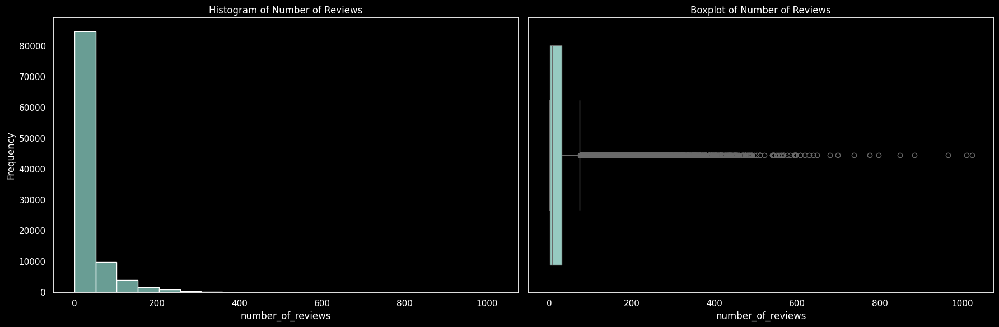

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["number_of_reviews"], bins=20)
plt.title('Histogram of Number of Reviews')
plt.xlabel("number_of_reviews")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "number_of_reviews")
plt.title('Boxplot of Number of Reviews')
plt.xlabel("number_of_reviews")
plt.ylabel('')

plt.tight_layout()
plt.show()

In [ ]:
data.loc[data["number_of_reviews"] == 0, ["number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]]

,number_of_reviews,last_review,reviews_per_month,review_rate_number
2,0.0,NaT,NaN,5.0
20,0.0,NaT,NaN,3.0
27,0.0,NaT,NaN,NaN
37,0.0,NaT,NaN,NaN
39,0.0,NaT,NaN,3.0
...,...,...,...,...
102590,0.0,NaT,NaN,1.0
102592,0.0,NaT,NaN,2.0
102594,0.0,NaT,NaN,3.0
102596,0.0,NaT,NaN,5.0


In [ ]:
print(round((len(data.loc[data["number_of_reviews"] == 0]) / len(data)) * 100, 2), "% of the listings have 0 reviews.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"].notna())]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"].isna())]) / len(data)) * 100, 2), "% of the listings have 0 reviews and don't have a review_rate_number.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"] == 5)]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number of 5.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"] == 0)]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number of 0.")

15.36 % of the listings have 0 reviews.
15.33 % of the listings have 0 reviews but have a review_rate_number.
0.03 % of the listings have 0 reviews and don't have a review_rate_number.
3.51 % of the listings have 0 reviews but have a review_rate_number of 5.
0.0 % of the listings have 0 reviews but have a review_rate_number of 0.


Only 0.03% of all rows have a missing value for review_rate_number when their number_of_reviews is equal to zero, and 3.51% have a value of 5. It would be expected that when there are no reviews the review_rate_number would either be NaN due to the lack of reviews or be set automatically to 5 or to 0; however, the amount of rows containing this logic is very low.

<ipython-input-149-c0f2d486fcd8>:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-149-c0f2d486fcd8>:4: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



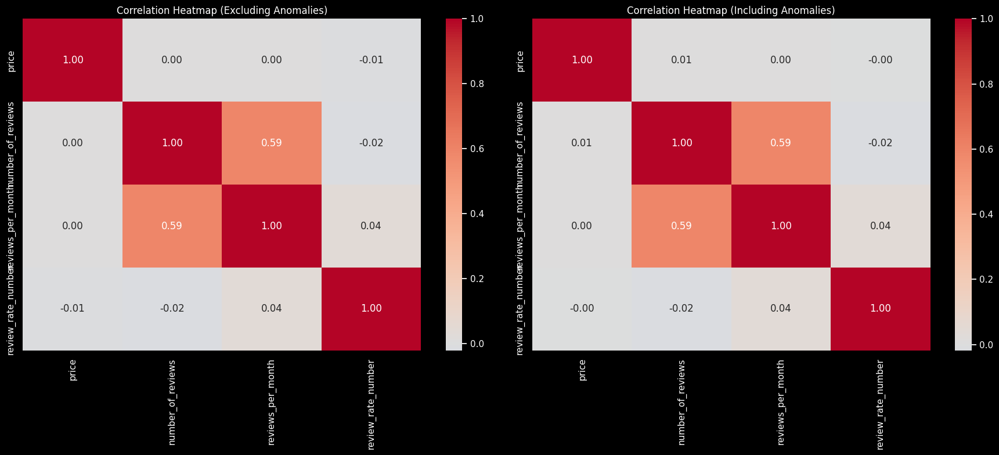

In [ ]:
# To see if there is a difference in correlation with & without
cols_review = ["price", "number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]
data_temp_corrmatrix = data.loc[data["number_of_reviews"] != 0, cols_review].corr()
data_corrmatrix2 = data[cols_review].corr()

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.heatmap(data_temp_corrmatrix, annot=True, cmap="coolwarm", fmt=".2f", center=0, ax=axes[0])
axes[0].set_title("Correlation Heatmap (Excluding Anomalies)")

sns.heatmap(data_corrmatrix2, annot=True, cmap="coolwarm", fmt=".2f", center=0, ax=axes[1])
axes[1].set_title("Correlation Heatmap (Including Anomalies)")

plt.tight_layout()
plt.show()

In [ ]:
# Since the correlations have barley changed, all these values will be set to zero
data.loc[data["number_of_reviews"]==0, "review_rate_number"] = 0

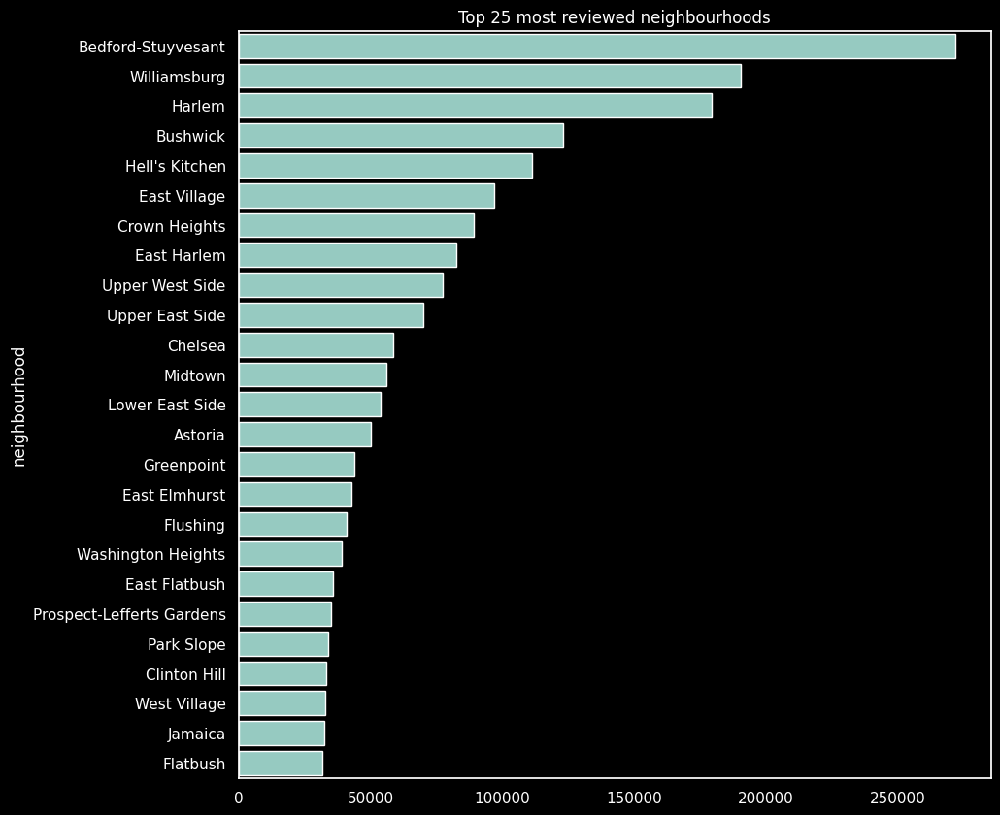

In [ ]:
top_25_reviewed_neighbourhoods = data.loc[data["number_of_reviews"] > 0].groupby(['neighbourhood'])['number_of_reviews'].sum().sort_values(ascending=False).head(25)
plt.figure(figsize=(10,10))
plt.title("Top 25 most reviewed neighbourhoods")
sns.barplot(x=top_25_reviewed_neighbourhoods.values,y=top_25_reviewed_neighbourhoods.index)
plt.show()

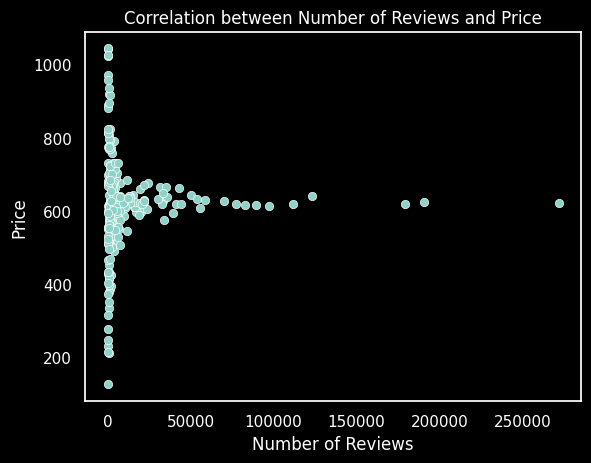

<ipython-input-152-8583a5c36392>:26: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




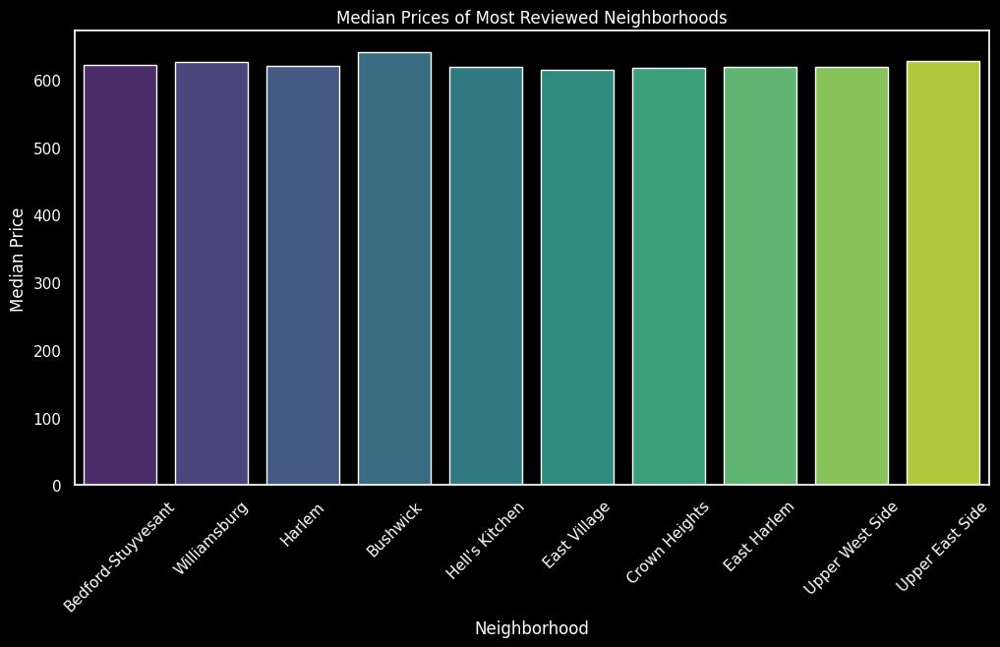

<ipython-input-152-8583a5c36392>:34: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




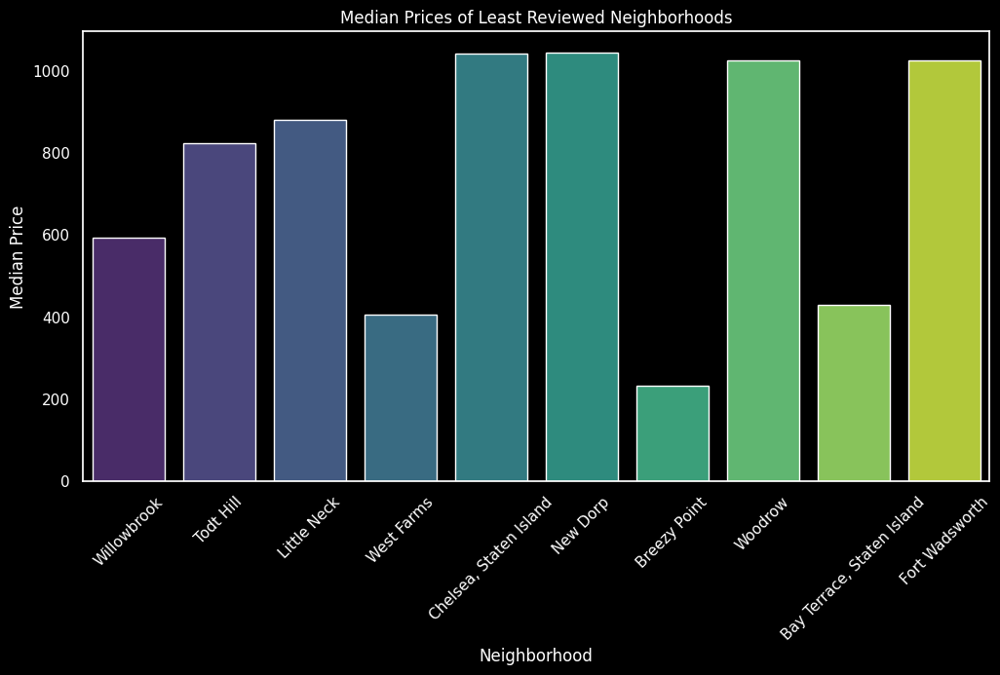

In [ ]:
# Calculate the median price for each neighborhood
median_prices = data.groupby('neighbourhood')['price'].median().reset_index()

# Calculate the total number of reviews for each neighborhood
total_reviews = data.groupby('neighbourhood')['number_of_reviews'].sum().reset_index()

# Merge the median prices and total reviews dataframes on 'neighborhood'
neighborhood_stats = pd.merge(median_prices, total_reviews, on='neighbourhood', how='inner')

# Plot correlation between number of reviews and price
sns.scatterplot(data=neighborhood_stats, x='number_of_reviews', y='price')
plt.title('Correlation between Number of Reviews and Price')
plt.xlabel('Number of Reviews')
plt.ylabel('Price')
plt.show()

# Sort neighborhoods by total reviews
neighborhood_stats_sorted = neighborhood_stats.sort_values(by='number_of_reviews', ascending=False)

# Select most and least reviewed neighborhoods (e.g., top 10 and bottom 10)
most_reviewed = neighborhood_stats_sorted.head(10)
least_reviewed = neighborhood_stats_sorted.tail(10)

# Plot median prices of most and least reviewed neighborhoods
plt.figure(figsize=(12, 6))
sns.barplot(data=most_reviewed, x='neighbourhood', y='price', palette='viridis')
plt.title('Median Prices of Most Reviewed Neighborhoods')
plt.xlabel('Neighborhood')
plt.ylabel('Median Price')
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(data=least_reviewed, x='neighbourhood', y='price', palette='viridis')
plt.title('Median Prices of Least Reviewed Neighborhoods')
plt.xlabel('Neighborhood')
plt.ylabel('Median Price')
plt.xticks(rotation=45)
plt.show()

#### Review Rate Number

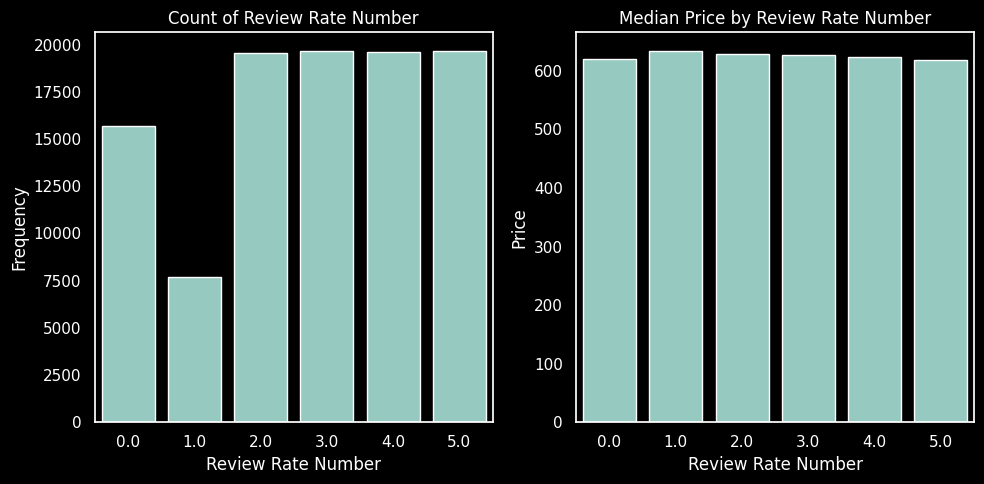

In [ ]:
plt.figure(figsize=(10, 5))

# Plot count plot for 'review_rate_number' column
plt.subplot(1, 2, 1)
sns.countplot(data=data, x='review_rate_number')
plt.title('Count of Review Rate Number')
plt.xlabel('Review Rate Number')
plt.ylabel('Frequency')

# Plot bar plot for median price by review_rate_number
plt.subplot(1, 2, 2)
data_summary = data.groupby('review_rate_number')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, x='review_rate_number', y='price')
plt.title('Median Price by Review Rate Number')
plt.xlabel('Review Rate Number')
plt.ylabel('Price')

plt.tight_layout()
plt.show()

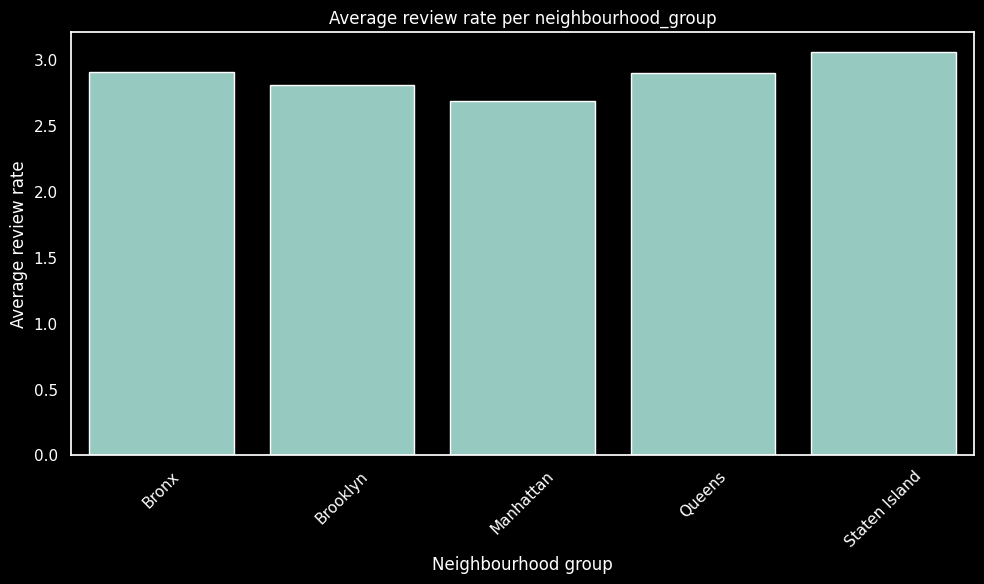

In [ ]:
review_rate_per_neighbourhood_group = data.groupby('neighbourhood_group')['review_rate_number'].mean().reset_index()

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=review_rate_per_neighbourhood_group, x='neighbourhood_group', y='review_rate_number')
plt.xlabel('Neighbourhood group')
plt.ylabel('Average review rate')
plt.title('Average review rate per neighbourhood_group')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

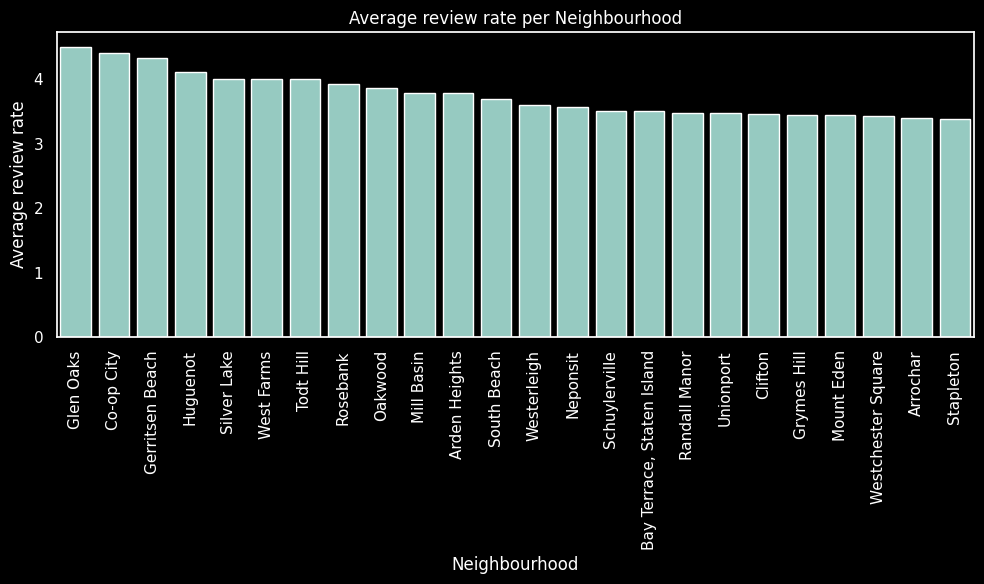

In [ ]:
avg_rating_per_neighbourhood = data.groupby(['neighbourhood'])['review_rate_number'].mean().sort_values(ascending=False)[0:24]

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(y = avg_rating_per_neighbourhood.values, x=avg_rating_per_neighbourhood.index)
plt.xlabel('Neighbourhood')
plt.ylabel('Average review rate')
plt.title('Average review rate per Neighbourhood')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

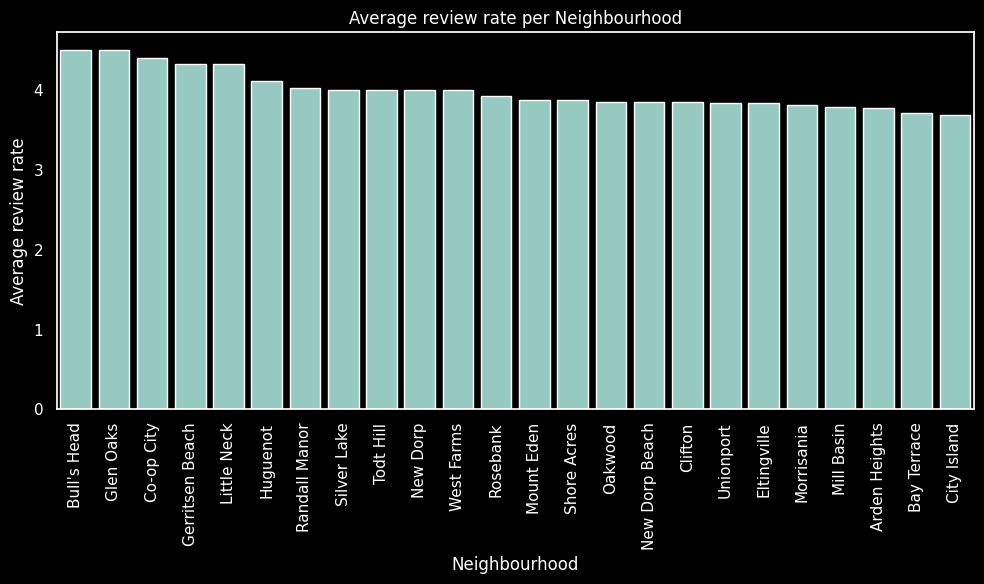

In [ ]:
# Testing to see if there is a difference here based on number_of_reviews being 0 based on analysis before
avg_rating_per_neighbourhood = data.loc[data["number_of_reviews"] > 0].groupby(['neighbourhood'])['review_rate_number'].mean().sort_values(ascending=False)[0:24]

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(y = avg_rating_per_neighbourhood.values, x=avg_rating_per_neighbourhood.index)
plt.xlabel('Neighbourhood')
plt.ylabel('Average review rate')
plt.title('Average review rate per Neighbourhood')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

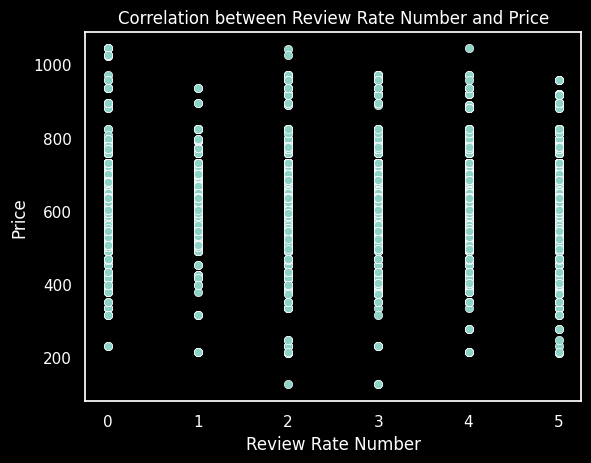

<ipython-input-157-9eaa9384c116>:23: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




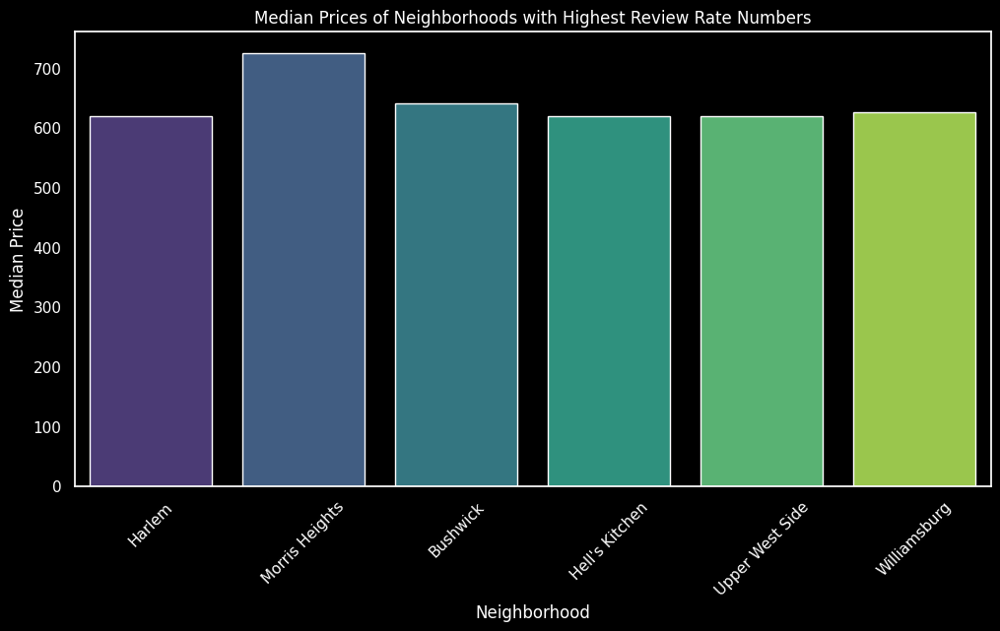

<ipython-input-157-9eaa9384c116>:31: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




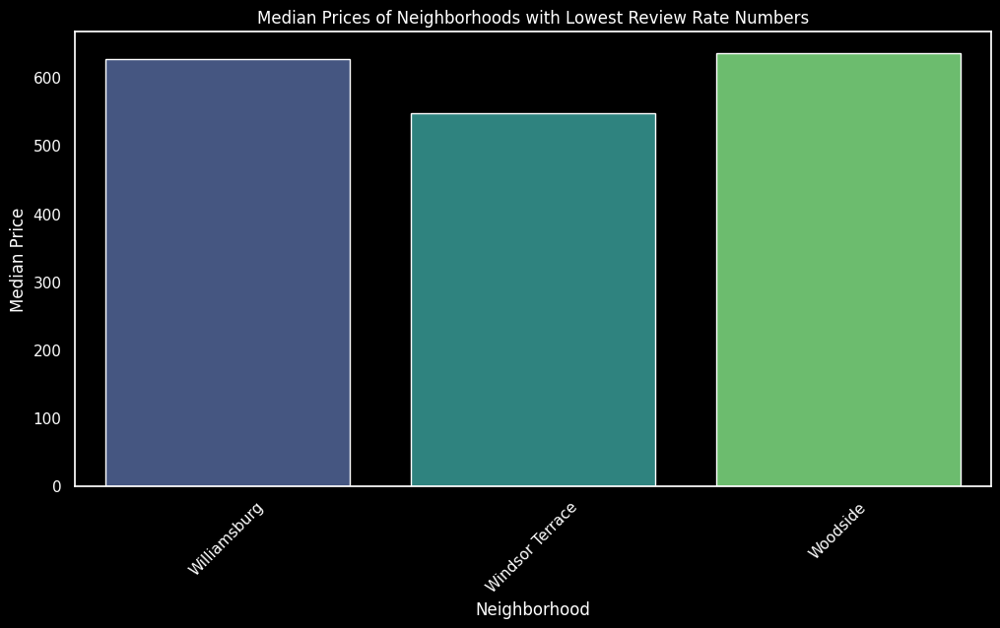

In [ ]:
# Calculate the median price for each neighborhood
median_prices = data.groupby('neighbourhood')['price'].median().reset_index()

# Merge the median prices and review rate dataframes on 'neighborhood'
neighborhood_stats = pd.merge(median_prices, data[['neighbourhood', 'review_rate_number']], on='neighbourhood', how='inner')

# Plot correlation between review rate number and price
sns.scatterplot(data=neighborhood_stats, x='review_rate_number', y='price')
plt.title('Correlation between Review Rate Number and Price')
plt.xlabel('Review Rate Number')
plt.ylabel('Price')
plt.show()

# Sort neighborhoods by review rate number
neighborhood_stats_sorted = neighborhood_stats.sort_values(by='review_rate_number', ascending=False)

# Select neighborhoods with highest and lowest review rate numbers (e.g., top 10 and bottom 10)
highest_review_rate = neighborhood_stats_sorted.head(10)
lowest_review_rate = neighborhood_stats_sorted.tail(10)

# Plot median prices of neighborhoods with highest and lowest review rate numbers
plt.figure(figsize=(12, 6))
sns.barplot(data=highest_review_rate, x='neighbourhood', y='price', palette='viridis')
plt.title('Median Prices of Neighborhoods with Highest Review Rate Numbers')
plt.xlabel('Neighborhood')
plt.ylabel('Median Price')
plt.xticks(rotation=45)
plt.show()

plt.figure(figsize=(12, 6))
sns.barplot(data=lowest_review_rate, x='neighbourhood', y='price', palette='viridis')
plt.title('Median Prices of Neighborhoods with Lowest Review Rate Numbers')
plt.xlabel('Neighborhood')
plt.ylabel('Median Price')
plt.xticks(rotation=45)
plt.show()

#### Reviews per Month

In [ ]:
# Round all numbers up to their closest integer (since its impossible to have decimals)
data['reviews_per_month'] = np.ceil(data['reviews_per_month'])

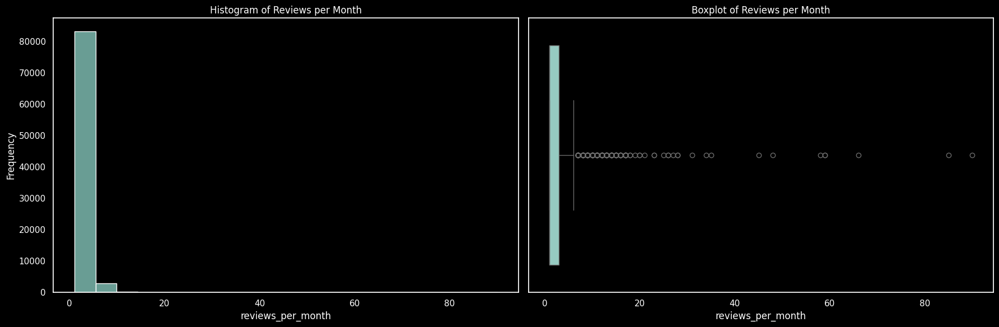

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["reviews_per_month"], bins=20)
plt.title('Histogram of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "reviews_per_month")
plt.title('Boxplot of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('')

plt.tight_layout()
plt.show()

In [ ]:
# Decide what to do with the outliers reviews_per_month >> its impossible that there are more than 15 reviews_per_month given that the minimum stay is 3 (refine this based on actual data)
print(len(data.loc[data["reviews_per_month"] >= 15]), "listings have more than 15 reviews_per_month and are considered anomalies.")

50 listings have more than 15 reviews_per_month and are considered anomalies.


In [ ]:
data = data.loc[data["reviews_per_month"] <= 15]

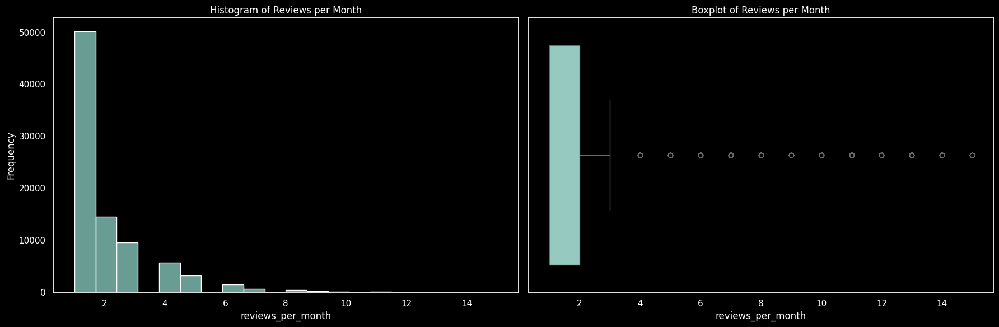

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["reviews_per_month"], bins=20)
plt.title('Histogram of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "reviews_per_month")
plt.title('Boxplot of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('')

plt.tight_layout()
plt.show()

#### Last Review

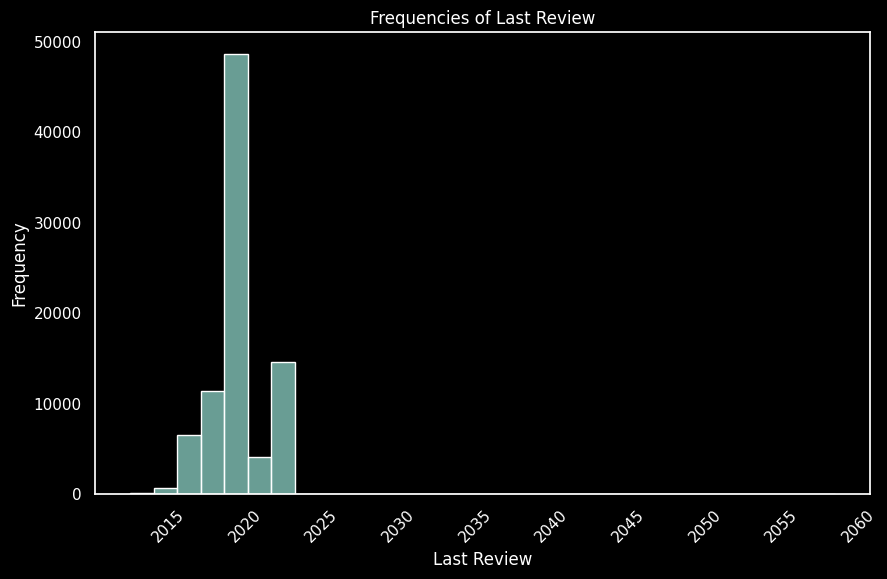

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(data['last_review'], bins=30, kde=False)
plt.title('Frequencies of Last Review')
plt.xlabel('Last Review')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Understanding which is last year of review
print(len(data.loc[(data["last_review"] >= "2021-01-01") & (data["last_review"] <= "2021-12-31")]), "listings have last_review date in 2021.")
print(len(data.loc[(data["last_review"] >= "2022-01-01") & (data["last_review"] <= "2022-12-31")]), "listings have last_review date in 2022.")
print(len(data.loc[(data["last_review"] >= "2023-01-01") & (data["last_review"] <= "2023-12-31")]), "listings have last_review date in 2023.")
print(len(data.loc[(data["last_review"] >= "2024-01-01") & (data["last_review"] <= "2024-12-31")]), "listings have last_review date in 2024.")
print(len(data.loc[(data["last_review"] >= "2025-01-01") & (data["last_review"] <= "2025-12-31")]), "listings have last_review date in 2025.")

6585 listings have last_review date in 2021.
10335 listings have last_review date in 2022.
0 listings have last_review date in 2023.
1 listings have last_review date in 2024.
1 listings have last_review date in 2025.


In [ ]:
# Assuming that the last review date is 2022
print(len(data.loc[data["last_review"] >= "2023-01-01"]), "listings have last_review date after 2022 and are considered anomalies.")

5 listings have last_review date after 2022 and are considered anomalies.


In [ ]:
data = data.loc[data["last_review"] <= "2022-12-31"]

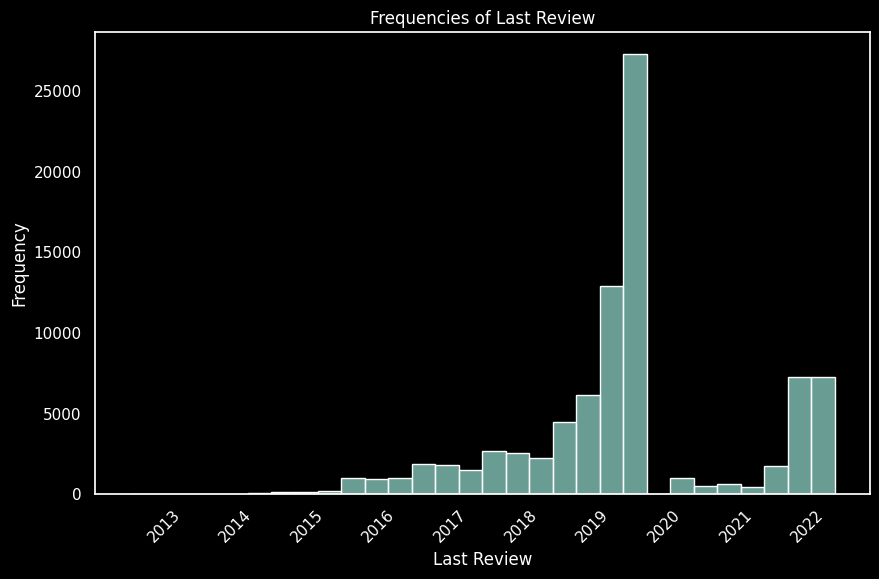

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(data['last_review'], bins=30, kde=False)
plt.title('Frequencies of Last Review')
plt.xlabel('Last Review')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

## Availability, Minimum Nights & Hosts Analysis

##### availability_365

In [ ]:
data[["availability_365"]].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
availability_365,86036.0,142.014761,133.907141,-10.0,6.0,101.0,266.0,3677.0


In [ ]:
## Availability 365 Column - negative values & extreme values

data[data.availability_365 < 0].availability_365.value_counts()

-5.0     46
-2.0     41
-9.0     40
-8.0     38
-3.0     36
-10.0    32
-1.0     30
-4.0     30
-7.0     27
-6.0     26
Name: availability_365, dtype: int64

In [ ]:
data.loc[data.availability_365 < 0, 'availability_365'] = 0
data.loc[data.availability_365 > 365, 'availability_365'] = 365

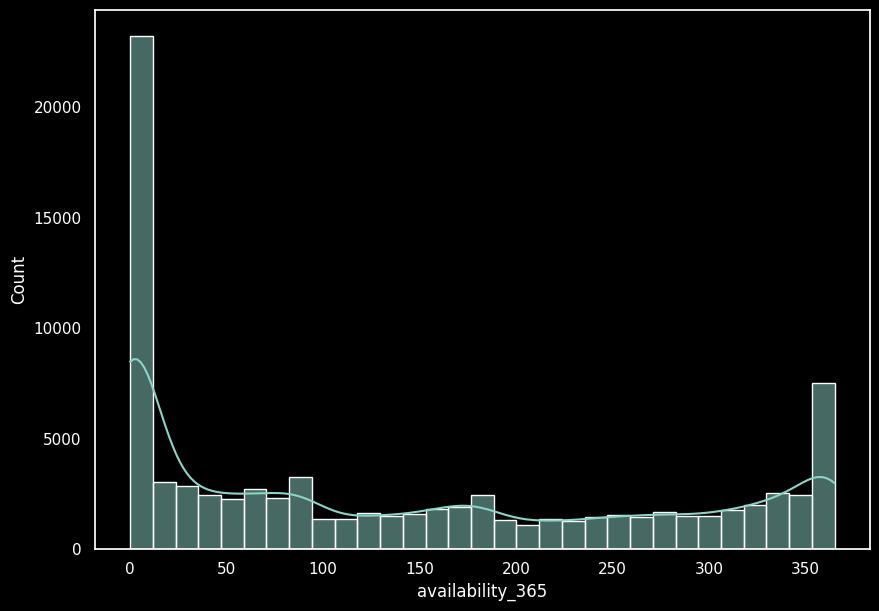

In [ ]:
plt.figure(figsize=(10,7))
sns.histplot(data=data, x='availability_365', kde=True)
plt.show()

In [ ]:
# make groups every 3 months
data['availability_grp'] = np.where(data['availability_365']<=90, '0-3 Months',
                   np.where((data['availability_365'] > 9) & (data['availability_365'] <= 180), '3-6 Months',
                   np.where((data['availability_365'] > 180) & (data['availability_365'] <= 270), '6-9 Months', '9-12 Months')))

In [ ]:
data['availability_grp'].value_counts()

0-3 Months     41552
9-12 Months    21086
3-6 Months     13118
6-9 Months     10456
Name: availability_grp, dtype: int64

<Axes: ylabel='availability_grp'>

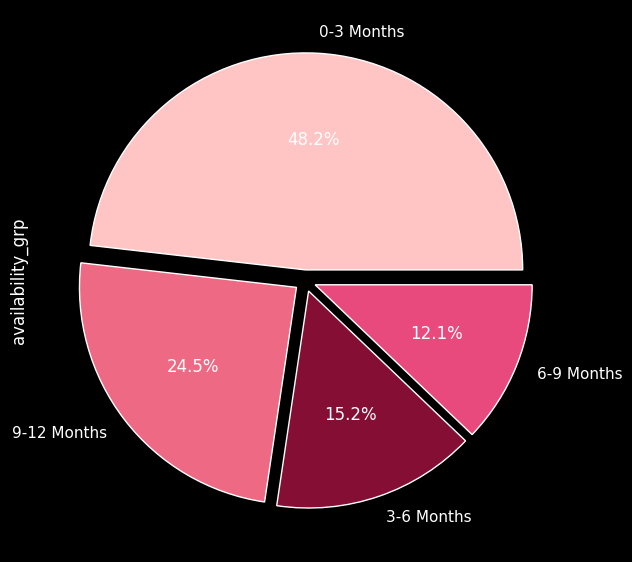

In [ ]:
# What is the most available set of dates of the year ?
round(data['availability_grp'].value_counts()/ data.shape[0]*100,2).plot.pie(autopct = '%1.1f%%',figsize =(7, 10),explode=(0.05,0.05,0.05,0.05),colors=['#FFC4C4','#EE6983','#850E35','#e84a7e'])

In [ ]:
availability_per_neighbourhood_group = data.groupby('neighbourhood_group')['availability_365'].mean()
fig = px.bar(availability_per_neighbourhood_group,
            x=availability_per_neighbourhood_group.index,
            y=availability_per_neighbourhood_group.values,
            labels={'x': 'Neighbourhood group', 'y': 'Average availability'},
            text=[str(round(i)) for i in availability_per_neighbourhood_group.values],
            title='Average availability per neighbourhood group',
            color_discrete_sequence=px.colors.sequential.deep,
            template='plotly_dark'
)

fig.update_layout(font=dict(size=20, color='white', family='Avenir'))

fig.show()

In [ ]:
import plotly.express as px

# Creating the box plot with the new 'availability_grp'
fig = px.box(
    data,
    x='availability_grp',
    y='price',
    category_orders={'availability_grp': ['0-3 Months', '3-6 Months', '6-9 Months', '9-12 Months']},  # Specifying the order
    template='plotly_dark',
    title='Availability Groups Compared to the Price'
)

# Updating the layout of the figure
fig.update_layout(
    xaxis_title="Availability Groups",
    yaxis_title="Price",
    font=dict(size=17, family="Franklin Gothic")
)

# Showing the figure
fig.show()

Insights

The analysis of Airbnb listing data reveals several key insights. Firstly, data cleaning was crucial, as erroneous entries such as negative availability values were identified and corrected. This process also involved capping availability values above 365 days, ensuring data accuracy. The resulting histogram indicates that a significant portion of listings are either consistently available or unavailable throughout the year, with patterns emerging between these extremes. Notably, nearly half of the listings are available for only 0-3 months, indicating a prevalence of short-term rental options. Borough-wise analysis highlights substantial variations in average availability, with Staten Island showing the highest at 325 days, potentially reflecting lower demand or longer rental preferences. Conversely, Manhattan and Brooklyn exhibit lower averages, hinting at higher turnover and demand for short-term rentals. Despite differing availability durations, median prices across groups remain relatively stable, suggesting strategic pricing by hosts to maintain competitiveness. However, outliers in certain categories indicate premium offerings possibly due to luxury features or unique advantages.

##### minimum nights

In [ ]:
data[['minimum_nights']].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
minimum_nights,85871.0,7.44292,27.92425,-365.0,2.0,3.0,5.0,5645.0


In [ ]:
print(data[data.minimum_nights < 0].minimum_nights.to_list())

[-10.0, -5.0, -1.0, -10.0, -12.0, -2.0, -3.0, -365.0, -200.0, -125.0, -10.0]


In [ ]:
# Minimum Nights Column
data.minimum_nights = data.minimum_nights.abs()

In [ ]:
pd.qcut(data.minimum_nights, q=4).value_counts()

(0.999, 2.0]     42246
(5.0, 5645.0]    18691
(2.0, 3.0]       14193
(3.0, 5.0]       10741
Name: minimum_nights, dtype: int64

In [ ]:
data[data.minimum_nights > 30][['name', 'minimum_nights', 'price']]

,name,minimum_nights,price
6,BlissArtsSpace!,45.0,71.0
7,BlissArtsSpace!,45.0,1060.0
62,NaN,180.0,779.0
82,Spacious luminous apt Upper West NYC,31.0,1056.0
107,Large 2 Bedroom Great for Groups!,90.0,500.0
...,...,...,...
102177,2 Bedroom 2 Bath in Harlem with MASSIVE Outdoor,31.0,931.0
102229,Art Deco Live / Work Studio in the East Village,75.0,352.0
102470,Spacious Private Room near Train and Prospect ...,31.0,452.0
102472,Park Slope Perfect 2 BR,31.0,1066.0


In [ ]:
# Change all values of minimum_nights above 30 to 30
data.loc[data.minimum_nights > 365, 'minimum_nights'] = 365

# Display the unique values of minimum_nights
data["minimum_nights"].value_counts()

2.0      21250
1.0      20996
3.0      14193
30.0      9341
4.0       5701
         ...  
166.0        1
275.0        1
131.0        1
175.0        1
142.0        1
Name: minimum_nights, Length: 108, dtype: int64

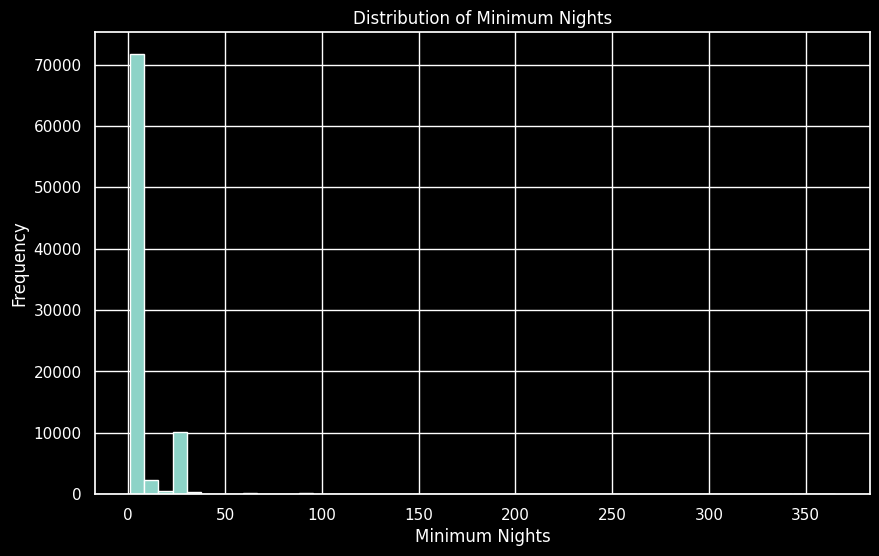

In [ ]:
# Plotting the histogram for the `minimum_nights` column
plt.figure(figsize=(10, 6))
data['minimum_nights'].hist(bins=50)
plt.title('Distribution of Minimum Nights')
plt.xlabel('Minimum Nights')
plt.ylabel('Frequency')
plt.show()


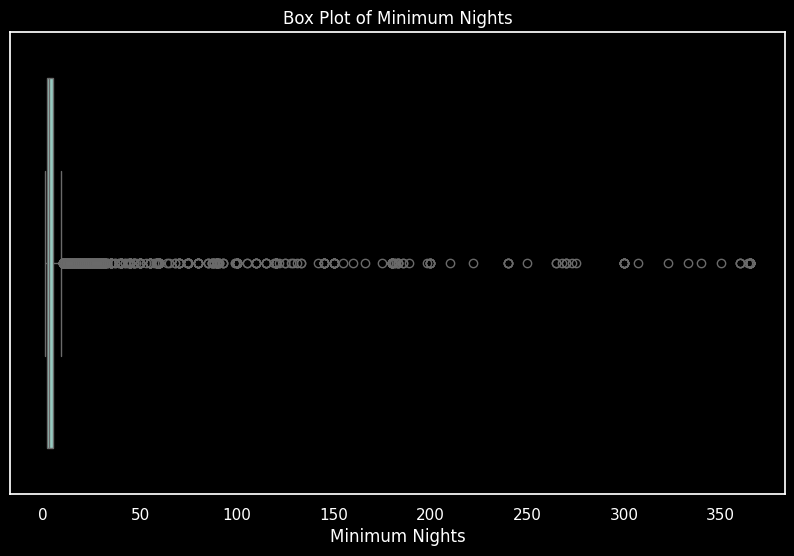

In [ ]:
# Create a box plot for the `minimum_nights` column
plt.figure(figsize=(10, 6))
sns.boxplot(x=data['minimum_nights'])
plt.title('Box Plot of Minimum Nights')
plt.xlabel('Minimum Nights')
plt.show()

In [ ]:
# Fill NaN values with the median
data['minimum_nights'].fillna(data['minimum_nights'].median(), inplace=True)

In [ ]:
import plotly.express as px
import pandas as pd

# Categorize the 'minimum_nights' into bins
bins = [-1, 5, 10, 50, float('inf')]
labels = ['0-5', '6-10', '11-50', '51+']
data['minimum_nights_bins'] = pd.cut(data['minimum_nights'], bins=bins, labels=labels)

# Comparing the binned minimum_nights to the price
fig = px.box(
    data,
    x='minimum_nights_bins',
    y='price',
    template='plotly_dark',
    title='Minimum Nights Compared to the Price',
    category_orders={'minimum_nights_bins': ['0-5', '6-10', '11-50', '51+']}  # This ensures the custom order is maintained
)

fig.update_layout(
    xaxis_title="Minimum Nights",
    yaxis_title="Price",
    font=dict(size=17, family="Franklin Gothic")
)

fig.show()

Insights

The analysis of minimum stay requirements in the Airbnb dataset unveils a diverse landscape, with the mean stay duration being approximately 7.99 nights, but with a wide dispersion indicated by a large standard deviation. The most common minimum stay is 1 night, representing the mode and the 25th percentile, indicating a prevalence of short-term accommodations. However, the presence of outliers, including a maximum stay requirement of 365 nights, suggests a minority of listings cater to significantly longer stays. Data cleaning steps involved converting negative values to their absolute counterparts and capping excessively high values at 365 nights for practicality. The distribution of minimum stay requirements shows a right-skewed pattern, with a notable disparity between mean and median values. Despite this variation, a box plot comparison demonstrates consistent median prices across different minimum night requirement bins, implying other factors play a more significant role in determining listing prices.

##### host analysis

In [ ]:
data.groupby('host_id').size().sort_values(ascending=False).value_counts()

1    85252
2      480
dtype: int64

In [ ]:
data.groupby('host_id')['calculated_host_listings_count'].max()

host_id
10001155629    1.0
10002395160    2.0
1000281623     3.0
10003128333    1.0
10003156404    1.0
              ... 
999574100      6.0
9996078091     3.0
9996246213     5.0
9996515662     3.0
9998961904     4.0
Name: calculated_host_listings_count, Length: 85732, dtype: float64

In [ ]:
data[['calculated_host_listings_count']].describe().transpose()

,count,mean,std,min,25%,50%,75%,max
calculated_host_listings_count,85952.0,7.01573,29.371195,1.0,1.0,1.0,2.0,332.0


In [ ]:
# Fill NaN values with the median
data['calculated_host_listings_count'].fillna(data['calculated_host_listings_count'].median(), inplace=True)

In [ ]:
# Define the bin edges
bins = [-0.01, 1, 3, float('inf')]
labels = ['0-1', '2-3', '3+']

# Bin data with pd.cut to create 'listings_count_bins'
data['listings_count_bins'] = pd.cut(data['calculated_host_listings_count'], bins=bins, labels=labels)

# Creating the box plot with the new 'listings_count_bins'
fig = px.box(
    data,
    x='listings_count_bins',
    y='price',
    template='plotly_dark',
    title='Listings Count Bins Compared to Price'
)

# Updating the layout of the figure
fig.update_layout(
    xaxis_title="Listings Count Bins",
    yaxis_title="Price",
    font=dict(size=17, family="Franklin Gothic")
)

# Showing the figure
fig.show()


Inisghts

The analysis of host listings in the Airbnb dataset reveals a highly skewed distribution, with most hosts managing only a few properties while a minority oversees a significantly larger portfolio. While the average number of listings per host is approximately 7.94, the presence of outliers, including hosts managing hundreds of listings, greatly influences this average and introduces a right-skewed distribution. This pattern suggests that the Airbnb market comprises predominantly of individual hosts or small businesses offering a limited number of properties, with a smaller subset of professional management companies or multi-property owners. The distribution of host listings impacts analyses and predictive models, emphasizing the need for data transformation or outlier treatment to ensure accurate insights. Furthermore, the comparison of median prices across different bins of host listing counts indicates that the number of listings managed by a host does not drastically impact the price point of the listings, suggesting market stability and standardized pricing practices within the Airbnb ecosystem.

## Location Analysis

In [ ]:
country_columns = ['country', 'country_code', 'lat', 'long', 'neighbourhood', 'neighbourhood_group']
data.dropna(subset=country_columns, inplace=True)

In [ ]:
data['neighbourhood_group'].value_counts()

Brooklyn         35564
Manhattan        35542
Queens           11370
Bronx             2336
Staten Island      839
Name: neighbourhood_group, dtype: int64

In [ ]:
unique_neighbourhood_counts = data.groupby('neighbourhood_group')['neighbourhood'].nunique()
unique_neighbourhood_counts

neighbourhood_group
Bronx            48
Brooklyn         48
Manhattan        32
Queens           52
Staten Island    43
Name: neighbourhood, dtype: int64

In [ ]:
unique_neighbourhood_counts = data.groupby('neighbourhood_group')['neighbourhood'].count()
unique_neighbourhood_counts

neighbourhood_group
Bronx             2336
Brooklyn         35564
Manhattan        35542
Queens           11370
Staten Island      839
Name: neighbourhood, dtype: int64

In [ ]:
data.drop(['country', 'country_code'], axis=1, inplace=True)

In [ ]:
data['lat'].describe()

count    85651.000000
mean        40.727422
std          0.056355
min         40.504560
25%         40.687670
50%         40.721350
75%         40.762670
max         40.916970
Name: lat, dtype: float64

In [ ]:
data['long'].describe()

count    85651.000000
mean       -73.948548
std          0.050308
min        -74.249840
25%        -73.982110
50%        -73.953730
75%        -73.930945
max        -73.705220
Name: long, dtype: float64

In [ ]:
#Plot char on the neighbourhood group :
ng = data["neighbourhood_group"].value_counts()
fig = px.bar(y = ng.values,
             x = ng.index,
             color = ng.index,
             color_discrete_sequence=px.colors.sequential.RdBu,
             text = ng.values,
             template="plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Neighbourhood group",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [ ]:
#Comparing the price and place :
fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood_group",
           hover_data=["neighbourhood_group", "price"],
           color="price",
           color_discrete_sequence=px.colors.sequential.PuBuGn,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17))
fig.show()

In [ ]:
# Group data by neighborhood and calculate descriptive statistics for price
price_stats_by_neighborhood = data.groupby('neighbourhood_group')['price'].describe()

# Display the statistics
price_stats_by_neighborhood

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group,,,,,,,,
Bronx,2336.0,626.946490,325.569330,50.0,350.00,633.0,906.0,1200.0
Brooklyn,35564.0,627.350101,331.748916,50.0,342.00,626.0,914.0,1200.0
Manhattan,35542.0,623.057622,331.144581,50.0,338.00,622.0,911.0,1200.0
Queens,11370.0,630.492084,335.585240,50.0,337.25,630.0,924.0,1200.0
Staten Island,839.0,624.796186,326.748544,50.0,348.50,628.0,910.0,1200.0


In [ ]:
fig = px.box(data,
             x='price',
             y='neighbourhood_group',
             title='Price Distribution by Neighbourhood',
             template="plotly_dark")
fig.update_traces(quartilemethod="inclusive")
fig.show()

In [ ]:
# Lowercase conversion for uniformity
data['neighbourhood'] = data['neighbourhood'].str.lower()

# Inspect unique values for anomalies
print(data['neighbourhood'].unique())

['kensington' 'midtown' 'clinton hill' 'east harlem' 'murray hill'
 'bedford-stuyvesant' "hell's kitchen" 'upper west side' 'chinatown'
 'south slope' 'bushwick' 'lower east side' 'east village' 'fort greene'
 'harlem' 'prospect-lefferts gardens' 'long island city' 'williamsburg'
 'greenpoint' 'kips bay' 'soho' 'chelsea' 'upper east side'
 'prospect heights' 'park slope' 'flatbush' 'brooklyn heights' 'gowanus'
 'washington heights' 'west village' 'flatlands' 'carroll gardens'
 'st. george' 'highbridge' 'financial district' 'ridgewood'
 'morningside heights' 'jamaica' 'flatiron district' 'windsor terrace'
 'roosevelt island' 'greenwich village' 'little italy' 'east flatbush'
 'tompkinsville' 'astoria' 'crown heights' 'inwood' 'kingsbridge'
 'boerum hill' 'two bridges' 'rockaway beach' 'nolita' 'woodlawn'
 'sunnyside' 'university heights' 'gramercy' 'allerton' 'east new york'
 'theater district' 'concourse village' 'sheepshead bay' 'emerson hill'
 'fort hamilton' 'bensonhurst' 'tribeca' 

In [ ]:
#analysis of neighbourhood
data['neighbourhood'].value_counts()

bedford-stuyvesant        6926
williamsburg              6520
harlem                    4719
bushwick                  4082
hell's kitchen            3259
                          ... 
gerritsen beach              3
glen oaks                    2
woodrow                      1
chelsea, staten island       1
new dorp                     1
Name: neighbourhood, Length: 223, dtype: int64

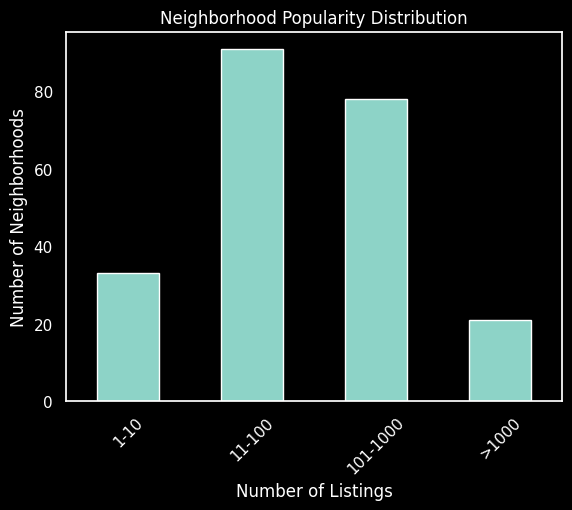

In [ ]:
neighbourhood_counts = data['neighbourhood'].value_counts()

# Bin the listing counts
bins = [0, 10, 100, 1000, neighbourhood_counts.max()]
# Use pd.cut to categorize each neighborhood into bins
binned_neighbourhood_counts = pd.cut(neighbourhood_counts, bins, labels=["1-10", "11-100", "101-1000", ">1000"])

# Count how many neighborhoods fall into each bin
binned_neighbourhood_counts = binned_neighbourhood_counts.value_counts().sort_index()

# Plot
binned_neighbourhood_counts.plot(kind='bar')
plt.title('Neighborhood Popularity Distribution')
plt.xlabel('Number of Listings')
plt.ylabel('Number of Neighborhoods')
plt.xticks(rotation=45)
plt.show()

In [ ]:
#create a mean neighbourhood price column
mean_price_by_neighbourhood = data.groupby('neighbourhood')['price'].mean().sort_values(ascending=False).round(2)
mean_price_by_neighbourhood = mean_price_by_neighbourhood.reset_index()

#display the mean price by neighbourhood
mean_price_by_neighbourhood

,neighbourhood,price
0,new dorp,1048.00
1,"chelsea, staten island",1042.00
2,little neck,906.33
3,new dorp beach,856.71
4,riverdale,840.92
...,...,...
218,castle hill,308.00
219,rossville,300.67
220,spuyten duyvil,293.44
221,lighthouse hill,107.67


In [ ]:
fig = px.histogram(mean_price_by_neighbourhood, x='price',
                   nbins=20,
                   title='Price Distribution by Neighbourhood',
                   labels={'price': 'Price ($)'},
                   template='plotly_dark')

fig.update_layout(xaxis_title='Mean Price ($)',
                  yaxis_title='Count',
                  bargap=0.2)

fig.show()

In [ ]:
#insert the mean price by neighbourhood into the dataframe
data = pd.merge(data, mean_price_by_neighbourhood, on='neighbourhood', how='left')

In [ ]:
data.rename(columns={'price_x': 'price', 'price_y': 'mean_neighbourhood_price'}, inplace=True)

In [ ]:
# Use qcut to create quartile-based bins
data['price_bin'] = pd.qcut(data['mean_neighbourhood_price'], q=6, precision=0)

# Check the bin ranges and counts
price_bin_counts = data['price_bin'].value_counts().sort_index()

price_bin_counts

(77.0, 616.0]      15398
(616.0, 622.0]     15581
(622.0, 625.0]     17637
(625.0, 626.0]      8594
(626.0, 640.0]     14275
(640.0, 1048.0]    14166
Name: price_bin, dtype: int64

In [ ]:
data['price_bin'] = data['price_bin'].astype(str)

fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity=0.3,
           hover_name="neighbourhood",
           hover_data=["neighbourhood", "price_bin"],  # Adjusted to include "Price Bin"
           color="price_bin",  # Now coloring by "Price Bin"
           color_discrete_sequence=px.colors.qualitative.Plotly,  # Using a discrete color sequence
           title="Neighbourhoods and Price Bins Distribution",
           template="plotly_dark",
           zoom=10
          )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, font=dict(size=17, family="Franklin Gothic"))
fig.show()

#### Insights
- Brooklyn and Manhattan have the highest count of listings, each with over 35,000, making them the most significant areas for Airbnb in New York. The high number of listings suggests these areas are popular with guests, which could be due to tourist attractions, business centers, or cultural significance.
- Queens, Bronx, and Staten Island have fewer listings, indicating lower demand or fewer available properties for Airbnb. However, these areas might offer opportunities for market growth or could be targeted for guests looking for a quieter experience away from the busy centers.
- The box plot distribution for prices by neighborhood group reveals that while the median prices across neighborhoods are similar, the interquartile ranges and extremes vary, indicating different price volatilities. This could influence pricing strategies or suggest different market dynamics, such as luxury versus budget accommodation.
- The number of unique neighborhoods per neighborhood group varies, with Queens having the most (52) and Manhattan the least (32). There is substantial variance in average prices at the neighborhood level, ranging from around 78 to 1048 dollars, reflecting the diverse range of accommodation standards and locations.

We decided to utilize `neighbourhood_group` as the primary location feature for our predictive model in the New York Airbnb market analysis. This choice addresses data variability, where some neighborhoods present with few listings, potentially skewing price predictions. By aggregating at the neighbourhood group level, we ensure a balanced dataset, mitigating the risk of overfitting to sparse data and reducing the noise from outlier prices. This approach simplifies our model, enhancing interpretability and stability while capturing the essential geographical price influences within broader areas. This decision is pivotal for developing a robust and equitable pricing model across New York's diverse boroughs.

## *Booking type, Cancellation policy, Room type & Construction year*


### Booking type

In [ ]:
instant_bookable = data["instant_bookable"].value_counts()
fig = px.pie(
    values = instant_bookable.values,
    names = instant_bookable.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Instantly bookable',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
fig = px.box(
    x=data["instant_bookable"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'Instantly bookable?')
fig.update_layout(
    xaxis_title = "booking policy",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table('price', index='instant_bookable', columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
#Encoding for modelling
data["instant_bookable"] = data["instant_bookable"].apply(lambda x: 1 if x == True else 0)

### Cancellation policy

In [ ]:
#drop missing cancellation_policy rows
data['cancellation_policy'].isna().sum()
data = data.dropna(subset=['cancellation_policy'])

In [ ]:
cancellation_policy = data["cancellation_policy"].value_counts()
fig = px.pie(
    values = cancellation_policy.values,
    names = cancellation_policy.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Cancellation policy distribution',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
fig = px.box(
    x=data["cancellation_policy"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'cancellation policy compared to the price')
fig.update_layout(
    xaxis_title = "concellation policy",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index="cancellation_policy", columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
data['cancellation_policy'].value_counts()

moderate    28684
strict      28504
flexible    28463
Name: cancellation_policy, dtype: int64

In [ ]:
#Encoding for modelling: 0: flexible, 1: moderate, 2: strict
cancellation_policy_le = LabelEncoder()
data['cancellation_policy'] = cancellation_policy_le.fit_transform(data['cancellation_policy'])
data['cancellation_policy'].value_counts()

1    28684
2    28504
0    28463
Name: cancellation_policy, dtype: int64

### Room type

In [ ]:
rm = data["room_type"].value_counts()
fig = px.bar(y = rm.values,
             x = rm.index,
             color = rm.index,
             color_discrete_sequence=px.colors.diverging.RdBu,
             text = rm.values,
             title = "Room type",
             template = "plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [ ]:
room_type = data["room_type"].value_counts()
fig = px.pie(
    values = room_type.values,
    names = room_type.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Room type distribution',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
#a map on room types
fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood_group",
           hover_data=["neighbourhood_group", "room_type"],
           color="room_type",
            color_discrete_sequence=px.colors.qualitative.Dark24,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
#Room types compared to the price
fig = px.box(
    x=data["room_type"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'Room type compared to the price')
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index="room_type", columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
data['room_type'].value_counts()

Entire home/apt    45310
Private room       38550
Shared room         1687
Hotel room           104
Name: room_type, dtype: int64

In [ ]:
#Encoding for modelling  0: Entire home/apt, 1: Hotel room, 2: Private room, 3: Shared room
room_type_le = LabelEncoder()
data['room_type'] = room_type_le.fit_transform(data['room_type'])
data['room_type'].value_counts()

0    45310
2    38550
3     1687
1      104
Name: room_type, dtype: int64

### Construction year

In [ ]:
fig = px.histogram(data, x='construction_year', color='construction_year', color_discrete_sequence=px.colors.diverging.RdBu,
                   title="Construction Year Distribution", template="plotly_dark", range_y=[4800, 5400])
fig.update_layout(
    xaxis_title="Construction Year",
    yaxis_title="Count",
    font=dict(size=17, family="Franklin Gothic")
)
fig.show()

In [ ]:
price_per_year = data.groupby('construction_year')['price'].median()
fig = px.line(price_per_year,
            x=price_per_year.index,
            y=price_per_year.values,
            labels={'x': 'Construction year', 'y': 'Average price'},
            text=['$' + str(int(i)) for i in price_per_year.values],
            title='Average price per construction year in USD',
            color_discrete_sequence=px.colors.sequential.Teal_r,
            template='plotly_dark'
)

fig.update_layout(font=dict(size=16, color='white', family='Avenir'))

fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index='construction_year', columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Use the 'Viridis' color scale
                title="Mean Price by Construction Year and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=800)
fig.show()

## NLP (*name, house rules* columns) + host type (verified/not-verified)

**NLP - Important Note:**
Since our dataset is missing multiple columns from the original AirBnB data (original data dictionary below), we decided to conduct the NLP analysis to see if it is possible to extract meaningful details about apartments from text-based columns. We acknowledgfe that in reality, feature extracted from text produced by hosts might be risky to implement as a predictor in ML model due to high possibility of hosts to manipulate the predictions.

Data Dicitonary available in the following table: https://docs.google.com/spreadsheets/d/1b_dvmyhb_kAJhUmv81rAxl4KcXn0Pymz/edit#gid=1967362979

**Text Analsyis Methods**

*Frequency of words*
- Absolute frequencies of 1,2 and 3-grams in all documents (CountVectoriser)
- Absolute frequencies of 1,2 and 3-grams per price group (CountVectoriser)

*Importance of words*
- For all documents in general: Calculation of TF-IDF score per each n-grams in each document and calculating number of times each possible n-gram had highest score in individual documents.

*contrast score*
- For all words in all identified price groups, deteciton of 1,2 and 3-grams that appear mostly just in one class. Calculated by comparing the number of appearancess in one group divided by the number of appearances in other groups.

### Text Analysis Utilities

In [ ]:
def get_top_n_grams(data = pd.Series, ngram_range = (1, 1), n = 10):
    cv = CountVectorizer(ngram_range=ngram_range, stop_words='english')
    cv.fit(data)
    data_cv = cv.transform(data)
    data_cv = pd.DataFrame(data_cv.toarray(), columns=cv.get_feature_names_out())
    return data_cv.sum().sort_values(ascending=False).head(n)


def tfidf_analysis(data, ngram_range=(1, 1), stop_words='english'):
    tfidf = TfidfVectorizer(ngram_range=ngram_range, stop_words=stop_words)
    tfidf.fit(data)
    data_tfidf = tfidf.transform(data)
    data_tfidf = pd.DataFrame(data_tfidf.toarray(), columns=tfidf.get_feature_names_out())
    data_tfidf = data_tfidf.idxmax(axis=1).value_counts()
    return data_tfidf


# most important words in names for each price group

# for each price group create a separate concatinated document of all words in names
# for each document calculate frequency of each word
# for each word in each document calculate the following formula:
# frequency of word in the document / sum of frequencies of this word in all other documents

# Define functions for the process
def tokenize_and_count(df, n=1, column='name'):
    """
    Tokenizes the names and counts term frequencies for each price group and overall.
    """
    group_term_freq = defaultdict(Counter)  # Term frequency within each price group
    overall_term_freq = Counter()  # Overall term frequency across all groups

    stop_words = set(stopwords.words('english'))
    punctuation = set(string.punctuation)

    for _, row in df.iterrows():
        tokens = [token.lower() for token in word_tokenize(row[column]) if token.lower() not in stop_words and token not in punctuation]

        if n > 1:
            tokens = [' '.join(gram) for gram in ngrams(tokens, n)]

        group_term_freq[row['price_group']].update(tokens)
        overall_term_freq.update(tokens)

    return group_term_freq, overall_term_freq


def calculate_contrast_scores(group_term_freq, overall_term_freq):
    """
    Calculates contrast scores for terms in each price group.
    """
    contrast_scores = {group: {} for group in group_term_freq}

    for group in group_term_freq:
        for term in group_term_freq[group]:
            term_freq_in_group = group_term_freq[group][term]
            term_freq_in_other_groups = overall_term_freq[term] - term_freq_in_group
            contrast_score = term_freq_in_group / (term_freq_in_other_groups + 1)
            contrast_scores[group][term] = contrast_score

    return contrast_scores


def select_top_terms(contrast_scores, top_n=5):
    """
    Selects the top N terms for each price group based on contrast scores.
    """
    top_terms = {group: None for group in contrast_scores}

    for group, scores in contrast_scores.items():
        sorted_terms = sorted(scores.items(), key=lambda x: x[1], reverse=True)
        top_terms[group] = sorted_terms[:top_n]

    return top_terms

### Listing Names

In [ ]:
# general analysis

names = data.name.copy()

names = names.dropna()

names = names.str.lower()

In [ ]:

stop_words = set(stopwords.words('english'))

names = names.apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stop_words]))

# remove punctuation from names

names = names.apply(lambda x: x.translate(str.maketrans('', '', string.punctuation)))

#### Abolute n-gram Frequencies in all documents

In [ ]:
# words
names_cv_1 = get_top_n_grams(names, ngram_range=(1, 1), n=10)

names_cv_1

room         17912
private      13489
bedroom      13320
apartment    11760
cozy          9174
apt           7861
brooklyn      7445
studio        7237
spacious      6382
manhattan     6098
dtype: int64

In [ ]:
# bi-grams
names_cv_2 = get_top_n_grams(names, ngram_range=(2, 2), n=10)

names_cv_2

private room         5090
central park         2262
east village         1945
private bedroom      1730
bedroom apartment    1594
cozy room            1570
upper east           1076
times square         1070
new york             1030
bedroom apt          1022
dtype: int64

In [ ]:
# gri-grams
names_cv_3 = get_top_n_grams(names, ngram_range=(3, 3), n=10)

names_cv_3

near central park        530
home away home           470
cozy private room        468
room private bathroom    276
new york city            267
sonder stock exchange    258
private room near        238
near prospect park       232
spacious private room    202
heart east village       192
dtype: int64

#### N-grams importance analysis (TF-IDF)
For each n-gram, number of documents in which it had top1 TF-IDF score

In [ ]:
# words
names_tfidf_1 = tfidf_analysis(names, ngram_range=(1, 1), stop_words='english')

names_tfidf_1.head(10)

upper           580
home            498
harlem          404
bushwick        352
prospect        349
great           327
williamsburg    315
bright          314
lovely          308
village         305
dtype: int64

In [ ]:
# bi-grams
names_tfidf_2 = tfidf_analysis(names, ngram_range=(2, 2), stop_words='english')

names_tfidf_2.head(10)

001apmnt like         857
away home              96
bedroom east           70
heart manhattan        70
room brooklyn          64
bedroom upper          64
private room           58
heart williamsburg     55
bedroom manhattan      54
heart east             54
dtype: int64

In [ ]:
# tri-grams
names_tfidf_3 = tfidf_analysis(names, ngram_range=(3, 3), stop_words='english')

names_tfidf_3.head(10)

001ll safe area                5036
home away home                   94
private room brooklyn            38
private room williamsburg        31
room heart williamsburg          30
water view king                  27
private room upper               25
room heart east                  23
beautiful bedroom apartment      23
private bedroom manhattan        22
dtype: int64

#### Word Frequency per Price Range

In [ ]:
def visualise_ngrams_per_price_pivot(df_text, text_col, n_gram=1, top_n=10):
    pt = df_text.groupby('price_group')[text_col]. \
      apply(lambda x: get_top_n_grams(x, ngram_range=(n_gram, n_gram), n=top_n)). \
        reset_index(). \
          rename(columns={'level_1': 'n_gram', text_col: 'frequency'}). \
          pivot_table(index='n_gram', columns='price_group', values='frequency', margins=False)

    fig = px.imshow(pt.T,
                labels=dict(color="frequency"),
                x=pt.index,
                y=pt.columns,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title=f"Frequency of most popular {str(n_gram)}-grams per price group",
                template="plotly_dark",
                width=800,
                height=500)
    fig.show()


In [ ]:
groups = 5

data['price_group'] = pd.qcut(data.price, q=groups)

In [ ]:
names_df = data[['name', 'price_group']].copy()

names_df.dropna(subset=['name'], inplace=True)

In [ ]:
names_df['name'] = names_df['name'].str.lower()

names_df['name'] = names_df['name'].apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stop_words]))

names_df['name'] = names_df['name'].apply(lambda x: x.translate(str.maketrans('', '', string.punctuation)))

names_df['price_group'] = names_df['price_group'].astype(str)

In [ ]:
visualise_ngrams_per_price_pivot(names_df, 'name')

In [ ]:
visualise_ngrams_per_price_pivot(names_df, 'name', n_gram=2)

In [ ]:
visualise_ngrams_per_price_pivot(names_df, 'name', n_gram=3)

#### Inter-group relative frequencies of terms (terms that appear often in a single group compared to their frequencies in all other groups)



In [ ]:
group_term_freq, overall_term_freq = tokenize_and_count(names_df, n=1)
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('doctors', 9.0), ('☝', 8.0), ('❤️❤️❤️', 8.0), ('voted', 7.0), ('✺', 6.0)]
Top terms for (49.999, 282.0]: [('900', 6.0), ('pacific', 6.0), ('111', 5.0), ('sprawling', 5.0), ('2comfy', 5.0)]
Top terms for (511.0, 739.0]: [('в', 8.0), ('visitors', 8.0), ('★huge', 6.0), ('nancy', 6.0), ('gc', 6.0)]
Top terms for (972.0, 1200.0]: [('brodway', 6.0), ('flexibility', 6.0), ('✔', 6.0), ('✤', 6.0), ('desirable', 5.5)]
Top terms for (282.0, 511.0]: [('essentials', 6.0), ('toilet', 5.0), ('3br2b', 5.0), ('bedroomprospect', 4.0), ('mary', 4.0)]


In [ ]:
group_term_freq, overall_term_freq = tokenize_and_count(names_df, n=2)
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('apt bedroom', 9.0), ('side great', 7.0), ('large suite', 7.0), ('floorthrough apartment', 6.0), ('gem best', 6.0)]
Top terms for (49.999, 282.0]: [('sun lit', 11.0), ('j trains', 8.0), ('bath brand', 8.0), ('hells kitchentimes', 7.0), ('room warehouse', 7.0)]
Top terms for (511.0, 739.0]: [('waterfront apt', 9.0), ('modern light', 9.0), ('flat east', 7.0), ('sunny carroll', 7.0), ('apt 3b', 7.0)]
Top terms for (972.0, 1200.0]: [('village gramercy', 7.0), ('15min central', 7.0), ('gramercy east', 7.0), ('1br available', 7.0), ('brownstone 2bd', 7.0)]
Top terms for (282.0, 511.0]: [('bdrm perfect', 8.0), ('5m walk', 8.0), ('dog lovers', 8.0), ('ideal family', 7.0), ('large sunlit', 7.0)]


In [ ]:
group_term_freq, overall_term_freq = tokenize_and_count(names_df, n=3)
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('good location 20', 9.0), ('west village brownstone', 8.0), ('east williamsburg private', 8.0), ('bedroom bedford stuyvesant', 8.0), ('spacious chelsea studio', 7.0)]
Top terms for (49.999, 282.0]: [('room harlem townhouse', 16.0), ('brooklyn heights private', 9.0), ('bath brand new', 8.0), ('spacious room north', 7.0), ('hells kitchentimes square', 6.0)]
Top terms for (511.0, 739.0]: [('bedroom lots light', 9.0), ('quiet sunny room', 8.0), ('sunny new room', 8.0), ('flat east village', 7.0), ('apt w outdoor', 7.0)]
Top terms for (972.0, 1200.0]: [('east village gramercy', 7.0), ('lofted bedroom east', 7.0), ('brooklyn sleeps 8', 7.0), ('15min central park', 7.0), ('1br apartment 25', 7.0)]
Top terms for (282.0, 511.0]: [('new modern luxury', 12.0), ('luxury apt room', 12.0), ('clean bright room', 7.0), ('renovated 1 bdrm', 6.0), ('sunny spacious greenpoint', 6.0)]


#### Finding apartment specifications in text

In [ ]:
# number of bedrooms specified in the name
names_df.name.str.match(r"\b\d+\s*(bedroom?s?|bed)\b").sum()

1374

In [ ]:
# number of bathrooms specified in the name
names_df.name.str.match(r"\b\d+\s*(bathroom?s?|toilet)\b").sum()

3

In [ ]:
# min/max number of guests
names_df.name.str.match(r"\b(maximum|minimum|max|min)\s*\d+\s*(guests?|people)\b").sum()

0

**Names Column - Insights**

Unfortunately, it was impossible to derive any apartment-specific features based on the contents of the column containing listing name. When analysing n-grams, specific phrases appeared for certain price ranges, however, the absolute frequencies of these phrases were too small (up to 4000 for 1-grams and up to 300 for 3-grams) to derive price influencing features or to distinguish phrases specific for certain price ranges.

The conclusion from the analysis of word frequency, importance and contract between price group didn't show any specific keywords appearing in individual price groups, neither, the analysis allowed to derive listing-speicifc features.

The recommendation regarding name column is to drop it before Modeling, as it does not seem to be useful for the purpose of the project.

### House Rules Column


In [ ]:
house_rules = data.house_rules.copy()
house_rules = house_rules.dropna()
house_rules = house_rules.str.lower()
house_rules = house_rules.apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stop_words]))
house_rules = house_rules.apply(lambda x: x.translate(str.maketrans('', '', string.punctuation)))

#### Absolute N-grams frequency in all documents

In [ ]:
house_rules_cv_1 = get_top_n_grams(house_rules, ngram_range=(1, 1), n=10)
house_rules_cv_1

smoking      25569
guests       15756
pets         15194
house        12854
building     10619
apartment    10300
parties       9917
clean         9390
allowed       9231
time          8090
dtype: int64

In [ ]:
# bi-grams
house_rules_cv_2 = get_top_n_grams(house_rules, ngram_range=(2, 2), n=10)
house_rules_cv_2

smoking pets            4648
smoking allowed         3623
let know                3450
pets smoking            2817
house rules             2591
residential building    2118
local time              1966
don allow               1966
building rules          1961
building building       1916
dtype: int64

In [ ]:
# tri-grams
house_rules_cv_3 = get_top_n_grams(house_rules, ngram_range=(3, 3), n=10)
house_rules_cv_3

remember residential building       1881
residential building building       1881
building building rules             1881
occupancy restrictions yearround    1881
restrictions yearround tenants      1862
yearround tenants respected         1862
apartment occupancy restrictions    1770
rules apartment occupancy           1770
building rules apartment            1770
require security deposit            1002
dtype: int64

#### N-grams importance (TF-IDF)

In [ ]:
# most important words in house_rules
house_rules_tfidf_1 = tfidf_analysis(house_rules, ngram_range=(1, 1), stop_words='english')
house_rules_tfidf_1.head(10)

0000           2081
pets           1809
building       1542
don             983
smoking         781
parties         363
location        308
preapproval     288
home            284
agree           254
dtype: int64

In [ ]:
# bi-grams
house_rules_tfidf_2 = tfidf_analysis(house_rules, ngram_range=(2, 2), stop_words='english')
house_rules_tfidf_2.head(10)

0000 charge               3138
smoking pets              1370
don allow                  983
apartment occupancy        767
respected parties          580
pets smoking               404
considered preapproval     288
check time                 204
air mattress               198
building staff             195
dtype: int64

In [ ]:
# tri-grams
house_rules_tfidf_3 = tfidf_analysis(house_rules, ngram_range=(3, 3), stop_words='english')
house_rules_tfidf_3.head(10)

0000 charge cleaning                6101
apartment occupancy restrictions     767
300 refunded days                    740
respected parties pets               580
24 hours booking                     243
respected parties smoking            232
1000pm safe neighborhood             183
cancel booked yo                     183
smoking pets parties                 172
address location disclosed           171
dtype: int64

#### N-grams frequency per price group

In [ ]:
house_rules_df = data[['house_rules', 'price_group']].copy()
house_rules_df.dropna(subset=['house_rules'], inplace=True)
house_rules_df['house_rules'] = house_rules_df['house_rules'].str.lower()

house_rules_df['house_rules'] = house_rules_df['house_rules'].apply(lambda x: ' '.join([word for word in x.split() if word.lower() not in stop_words]))
house_rules_df['house_rules'] = house_rules_df['house_rules'].apply(lambda x: x.translate(str.maketrans('', '', string.punctuation)))

house_rules_df['price_group'] = house_rules_df['price_group'].astype(str)

In [ ]:
visualise_ngrams_per_price_pivot(house_rules_df, 'house_rules')

In [ ]:
visualise_ngrams_per_price_pivot(house_rules_df, 'house_rules', n_gram=2)

In [ ]:
visualise_ngrams_per_price_pivot(house_rules_df, 'house_rules', n_gram=3)

#### Inter-group relative term frequencies

In [ ]:
# most important words in house_rules for each price group

group_term_freq, overall_term_freq = tokenize_and_count(house_rules_df, n=1, column='house_rules')
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('1210', 2.0), ('kaya', 1.7142857142857142), ('fluffiest', 1.7142857142857142), ('insists', 1.7142857142857142), ('66', 1.3333333333333333)]
Top terms for (49.999, 282.0]: [('1005', 4.0), ('1205', 3.0), ('204', 2.0), ('206', 2.0), ('1209', 2.0)]
Top terms for (511.0, 739.0]: [('1206', 3.0), ('1009', 2.0), ('calamities', 1.8333333333333333), ('arise', 1.8333333333333333), ('intending', 1.6666666666666667)]
Top terms for (972.0, 1200.0]: [('30pounds', 3.6666666666666665), ('1003', 2.0), ('1204', 2.0), ('1208', 2.0), ('sara', 1.5384615384615385)]
Top terms for (282.0, 511.0]: [('205', 4.0), ('1006', 2.0), ('69', 2.0), ('1207', 2.0), ('208', 2.0)]


In [ ]:
# most important words in house_rules for each price group

group_term_freq, overall_term_freq = tokenize_and_count(house_rules_df, n=2, column='house_rules')
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('8 nights', 5.0), ('children 15', 4.0), ('6 nights', 2.0), ('children 14', 2.0), ('time 17', 2.0)]
Top terms for (49.999, 282.0]: [('7 nights', 5.0), ('charge 1005', 4.0), ('monthly 1205', 3.0), ('professional smoking', 2.2), ('use seat', 2.2)]
Top terms for (511.0, 739.0]: [('time 16', 3.0), ('7 guest', 3.0), ('monthly 1206', 3.0), ('items 22', 3.0), ('building filled', 2.1666666666666665)]
Top terms for (972.0, 1200.0]: [('pets 30pounds', 3.6666666666666665), ('30pounds grill', 3.6666666666666665), ('grill back', 3.6666666666666665), ('yard guest', 3.6666666666666665), ('items 6', 3.0)]
Top terms for (282.0, 511.0]: [('charge 205', 4.0), ('10 star', 3.0), ('items 19', 3.0), ('house left', 2.0), ('found extra', 2.0)]


In [ ]:
# most important words in house_rules for each price group

group_term_freq, overall_term_freq = tokenize_and_count(house_rules_df, n=3, column='house_rules')
contrast_scores = calculate_contrast_scores(group_term_freq, overall_term_freq)
top_terms = select_top_terms(contrast_scores, top_n=5)

for group, terms in top_terms.items():
    print(f"Top terms for {group}: {terms}")

Top terms for (739.0, 972.0]: [('8 nights minimum', 5.0), ('pets children 15', 4.0), ('6 nights minimum', 2.0), ('pets children 14', 2.0), ('quiet time 17', 2.0)]
Top terms for (49.999, 282.0]: [('7 nights minimum', 5.0), ('keys charge 1005', 4.0), ('350 monthly 1205', 3.0), ('professional smoking pets', 2.2), ('pets please use', 2.2)]
Top terms for (511.0, 739.0]: [('quiet time 16', 3.0), ('7 guest maximum', 3.0), ('350 monthly 1206', 3.0), ('unreturned items 22', 3.0), ('building filled mix', 2.1666666666666665)]
Top terms for (972.0, 1200.0]: [('pets 30pounds grill', 3.6666666666666665), ('30pounds grill back', 3.6666666666666665), ('grill back yard', 3.6666666666666665), ('back yard guest', 3.6666666666666665), ('yard guest use', 3.6666666666666665)]
Top terms for (282.0, 511.0]: [('address charge 205', 4.0), ('10 star treatment', 3.0), ('unreturned items 19', 3.0), ('house left tidy', 2.0), ('left tidy found', 2.0)]


**House Rules - Insights**

The analysis of House Rules had similar goal to the analysis of Names of listings - to derive features specific to the listings, that might be missing in the dataset or to find keywords that appear more often in specific price ranges of listings.

Unfortuantely, neither of the analysis (frequency, importance, contrast of n-grams) did not show any significant relations between specific n-grams appearing in the column and the price of listings. Also it was not successful in deriving lisitng-specific features, due to rather generic words related to listings appearing to be most frequent / important among documents.

Even if the analysis would point out useful insights, we would need to interpret them with a grain of salt, due to the fact that nearly 50% of the rows had missing values in the House Rules column.

*Recommendation*

taking to the account high rate of missing values, as well as lack of significant discoveries in the column, we recommend dropping the column before modeling.

### Host Analsis

#### verified / unconfirmed hosts

In [ ]:
data.host_identity_verified.value_counts(dropna=False)

unconfirmed    42725
verified       42699
NaN              227
Name: host_identity_verified, dtype: int64

In [ ]:
data.host_identity_verified.fillna("unconfirmed", inplace=True)

In [ ]:
data.groupby('price_group').host_identity_verified.value_counts()

price_group      host_identity_verified
(49.999, 282.0]  unconfirmed               8594
                 verified                  8572
(282.0, 511.0]   unconfirmed               8576
                 verified                  8542
(511.0, 739.0]   unconfirmed               8607
                 verified                  8564
(739.0, 972.0]   unconfirmed               8608
                 verified                  8548
(972.0, 1200.0]  unconfirmed               8567
                 verified                  8473
Name: host_identity_verified, dtype: int64

In [ ]:
pivot_table = data.pivot_table(index='host_identity_verified', columns='neighbourhood_group', values='price', aggfunc='mean')

fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by host identity and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

**Verified host status - insights**

The variable doesn't seem to have any influence on the price as the distribution of unconfirmed and verified hosts is almost exactly equal in all price groups. Almost, we didn't detect any significant difference of price of the flats among various neighborhoods for both group of hosts (confirmed, unconfirmed).

#### Hosts with multiple flats in New York

In [ ]:
data.groupby('host_id').size().sort_values(ascending=False).value_counts()

1    84691
2      480
dtype: int64

#### Hosts with multiple listings in general

In [ ]:
df_listings = data.calculated_host_listings_count.value_counts().reset_index().rename(columns={'index':'n_listings'}).sort_values(by='n_listings')



In [ ]:
data.loc[data.calculated_host_listings_count == 327].head()

,id,name,host_id,host_identity_verified,host_name,neighbourhood_group,neighbourhood,lat,long,instant_bookable,cancellation_policy,room_type,construction_year,price,service_fee,minimum_nights,number_of_reviews,last_review,reviews_per_month,review_rate_number,calculated_host_listings_count,availability_365,house_rules,availability_grp,minimum_nights_bins,listings_count_bins,mean_neighbourhood_price,price_bin,price_group
31819,22151665,Sonder | 180 Water | Premier 1BR + Rooftop,87077207896,unconfirmed,Sonder (NYC),Manhattan,financial district,40.70771,-74.00641,0,2,0,2004.0,335.0,67.0,29.0,1.0,2019-05-29,1.0,3.0,327.0,219.0,Please remember that this is a residential bui...,6-9 Months,11-50,3+,619.42,"(616.0, 622.0]","(282.0, 511.0]"
32039,22314041,Sonder | 180 Water | Charming 1BR + Rooftop,54299500257,unconfirmed,Sonder (NYC),Manhattan,financial district,40.70743,-74.00443,0,1,0,2006.0,1123.0,225.0,29.0,1.0,2019-05-21,1.0,4.0,327.0,159.0,NaN,3-6 Months,11-50,3+,619.42,"(616.0, 622.0]","(972.0, 1200.0]"
32853,22966307,Sonder | The Nash | Artsy 1BR + Rooftop,88140939861,unconfirmed,Sonder (NYC),Manhattan,murray hill,40.74792,-73.97614,1,1,0,2012.0,368.0,74.0,2.0,8.0,2019-06-09,2.0,5.0,327.0,91.0,"Dear Guest, Thank you for appreciating that I ...",3-6 Months,0-5,3+,622.67,"(622.0, 625.0]","(282.0, 511.0]"
32854,22966859,Sonder | The Nash | Lovely Studio + Rooftop,19755355435,unconfirmed,Sonder (NYC),Manhattan,murray hill,40.74771,-73.97528,0,0,0,2009.0,1037.0,207.0,2.0,14.0,2019-06-10,3.0,3.0,327.0,81.0,I feel very responsible and accountable for yo...,0-3 Months,0-5,3+,622.67,"(622.0, 625.0]","(972.0, 1200.0]"
32855,22967412,Sonder | The Nash | Brilliant Studio + Rooftop,42123857275,verified,Sonder (NYC),Manhattan,murray hill,40.74845,-73.97446,0,1,0,2014.0,751.0,150.0,2.0,4.0,2019-06-08,1.0,5.0,327.0,137.0,"The usual ""social code"": There are three of us...",3-6 Months,0-5,3+,622.67,"(622.0, 625.0]","(739.0, 972.0]"


In [ ]:
data.loc[data.calculated_host_listings_count >= 30]

,id,name,host_id,host_identity_verified,host_name,neighbourhood_group,neighbourhood,lat,long,instant_bookable,cancellation_policy,room_type,construction_year,price,service_fee,minimum_nights,number_of_reviews,last_review,reviews_per_month,review_rate_number,calculated_host_listings_count,availability_365,house_rules,availability_grp,minimum_nights_bins,listings_count_bins,mean_neighbourhood_price,price_bin,price_group
1165,1767376,"2 BED TriBeCa, Beautiful-Renovated!",61943536745,unconfirmed,Mike,Manhattan,tribeca,40.71655,-74.01171,1,2,0,2006.0,486.0,97.0,30.0,2.0,2015-10-31,1.0,5.0,52.0,365.0,NaN,9-12 Months,11-50,3+,627.60,"(626.0, 640.0]","(282.0, 511.0]"
1227,1804933,ELEGANT MIDTOWN EAST STUDIO E.52 ST,2357957476,unconfirmed,Mike,Manhattan,midtown,40.75743,-73.96939,1,1,0,NaN,356.0,71.0,30.0,3.0,2016-12-31,1.0,2.0,52.0,0.0,Inn Boston Reservations requests that noise le...,0-3 Months,11-50,3+,607.26,"(77.0, 616.0]","(282.0, 511.0]"
1228,1805485,32nd St & Lexington Ave / Doorman Beautiful St...,52793927225,unconfirmed,Mike,Manhattan,kips bay,40.74190,-73.98160,1,0,0,NaN,536.0,107.0,30.0,2.0,2018-06-30,1.0,3.0,52.0,143.0,"This is our home (our primary residence), we j...",3-6 Months,11-50,3+,610.80,"(77.0, 616.0]","(511.0, 739.0]"
1229,1806037,COLUMBUS CIRCLE~FULLY FURNISHED!!!,2184468990,verified,Mike,Manhattan,hell's kitchen,40.76758,-73.98722,0,0,0,NaN,204.0,41.0,30.0,2.0,2016-08-15,1.0,1.0,52.0,302.0,No Smoking. No Pets.,9-12 Months,11-50,3+,619.98,"(616.0, 622.0]","(49.999, 282.0]"
1230,1806589,GRAMERCY PARK~FURNISHED E.20's ST P,83318082776,verified,Mike,Manhattan,kips bay,40.74189,-73.97833,1,2,0,NaN,720.0,144.0,30.0,3.0,2018-08-15,1.0,1.0,52.0,365.0,Please be respectful of other building residen...,9-12 Months,11-50,3+,610.80,"(77.0, 616.0]","(511.0, 739.0]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85560,6028371,*JAMES* Amazing Spacious 2 Bedroom- Bright!,37678424985,verified,Juliana,Manhattan,upper east side,40.76035,-73.96133,0,0,0,2021.0,806.0,161.0,30.0,8.0,2019-06-11,1.0,4.0,34.0,365.0,Be courteous and respectful to people in the h...,9-12 Months,11-50,3+,619.56,"(616.0, 622.0]","(739.0, 972.0]"
85562,6029475,*ODYSSEY* Sunny 1 Bedroom Apt- Bright & Cheery!,50618412686,unconfirmed,Juliana,Manhattan,upper west side,40.78181,-73.98466,1,2,0,2017.0,424.0,85.0,30.0,10.0,2019-04-01,1.0,3.0,34.0,129.0,"The property may be used only as a residence,...",3-6 Months,11-50,3+,620.12,"(616.0, 622.0]","(282.0, 511.0]"
85563,6030028,*WINDSONG* Serene 1 BR in Townhouse near Park,60449613505,unconfirmed,Juliana,Manhattan,upper west side,40.78289,-73.98477,1,2,0,2020.0,967.0,193.0,30.0,17.0,2019-06-17,1.0,4.0,34.0,164.0,No Smoking No Pets,3-6 Months,11-50,3+,620.12,"(616.0, 622.0]","(739.0, 972.0]"
85578,6039969,*SKYTRAIN* Studio Loft Apartment - Great Space!,15776313211,unconfirmed,Juliana,Manhattan,upper west side,40.78201,-73.98379,0,2,0,2009.0,110.0,22.0,30.0,9.0,2019-04-30,1.0,1.0,34.0,253.0,"No pet, No smoking - Quite hours : 9pm - 8am",6-9 Months,11-50,3+,620.12,"(616.0, 622.0]","(49.999, 282.0]"


**Hosts with Multiple Listings - Insights**

There seem to be a problem with host_id column, as when analysing the number of flats per host, we can see that extreme number of flats are listed by agenciel like Sonder (NYC) or Blueground (column: host_name). Since it's impossible to detect Agency-listed flats due to the problem with host IDs, it's difficult to create additional column specifying association with agency. However, this remain a topic for further exploration in case of acquisition of additional information or improving the general quality of the raw dataset.

### Dropping Unnecessary Text Columns

In [ ]:
data.drop(['name', 'host_name', 'house_rules', 'id', 'host_id'], axis=1, inplace=True)

In [ ]:
num_days = 10
g = data['last_review'].notna().cumsum()
days = pd.to_timedelta(data.groupby(g).cumcount().mul(num_days), unit='d')
data['last_review'].ffill().add(days)

0       2021-10-19
1       2022-05-21
2       2019-07-05
3       2018-11-19
4       2019-06-22
           ...    
85646   2019-06-29
85647   2019-01-04
85648   2015-09-06
85649   2015-07-06
85650   2015-10-11
Length: 85651, dtype: datetime64[ns]

## Modeling


### Dataset Cleaning & Encoding

In [ ]:
data.drop(['mean_neighbourhood_price', 'price_bin', 'price_group', 'lat', 'long'], axis=1, inplace=True)

In [ ]:
training_features = ['host_identity_verified', 'neighbourhood_group', 'instant_bookable',
                     'cancellation_policy', 'room_type', 'construction_year', 'number_of_reviews',
                     'reviews_per_month', 'review_rate_number', 'availability_grp',
                     'minimum_nights_bins', 'listings_count_bins', 'price']

In [ ]:
data_train = data[training_features].copy()

In [ ]:
# drop rows with na in construction_year columns
data_train = data_train.dropna(subset=['construction_year'])
data_train.review_rate_number = data_train.review_rate_number.fillna(data_train['review_rate_number'].median())
data_train.number_of_reviews = data_train.number_of_reviews.fillna(data_train['number_of_reviews'].median())

In [ ]:
data_train.isna().sum()

host_identity_verified    0
neighbourhood_group       0
instant_bookable          0
cancellation_policy       0
room_type                 0
construction_year         0
number_of_reviews         0
reviews_per_month         0
review_rate_number        0
availability_grp          0
minimum_nights_bins       0
listings_count_bins       0
price                     0
dtype: int64

In [ ]:
# Create a dictionary to store the label encoders for each column
label_encoders = {}

# Iterate over the columns of the dataframe
for column in data_train.select_dtypes(include=['category', 'object']):
    # Create a label encoder for the column
    le = LabelEncoder()
    # Fit the label encoder on the column and transform the values
    data_train[column] = le.fit_transform(data_train[column])
    # Store the label encoder in the dictionary
    label_encoders[column] = le

In [ ]:
data_train.dtypes

host_identity_verified      int64
neighbourhood_group         int64
instant_bookable            int64
cancellation_policy         int64
room_type                   int64
construction_year         float64
number_of_reviews         float64
reviews_per_month         float64
review_rate_number        float64
availability_grp            int64
minimum_nights_bins         int64
listings_count_bins         int64
price                     float64
dtype: object

In [ ]:
data_train.shape

(85490, 13)

In [ ]:
data_train.to_csv('data_train.csv')

### Modeling Utilities

In [ ]:
pd.DataFrame(columns=['id', 'MSE', 'MAE', 'RMSE', 'R2', 'train_time', 'train_timestamp', 'model_path', 'comment']).to_csv('modeling_results.csv')

In [ ]:
def evaluate_model(model: BaseEstimator, X_train: Any, y_train: Any,
                   X_test: Any, y_test: Any, model_identifier: str,
                   user_comment: str = "", csv_path: str = "modeling_results.csv"
                   ) -> Tuple[BaseEstimator, Dict[str, float], float]:
    """
    Evaluates a scikit-learn regression model on given training and testing data.

    Parameters
    ----------
    model : BaseEstimator
        A scikit-learn model to be evaluated.
    X_train : Any
        Training data features.
    y_train : Any
        Training data labels.
    X_test : Any
        Testing data features.
    y_test : Any
        Testing data labels.
    model_identifier : str
        A unique identifier for the model.
    user_comment : str, optional
        An optional comment about the model or evaluation.

    Returns
    -------
    model : BaseEstimator
        The evaluated model.
    metrics : Dict[str, float]
        A dictionary of calculated regression metrics.
    training_time : float
        Time taken to train the model, in seconds.
    """
    start_time = time()
    model.fit(X_train, y_train)
    end_time = time()

    predictions = model.predict(X_test)
    mse = mean_squared_error(y_test, predictions)
    mae = mean_absolute_error(y_test, predictions)
    r2 = r2_score(y_test, predictions)

    metrics = {'MSE': mse, 'RMSE': np.sqrt(mse), 'MAE': mae, 'R2': r2}

    training_time = end_time - start_time
    training_timestamp = strftime("%Y-%m-%d %H:%M:%S", localtime())

    model_path = save_model(model, model_identifier)
    update_results_csv(csv_path, model_identifier, metrics, training_time, training_timestamp, model_path, user_comment)

    df = pd.DataFrame({"Y_test": y_test , "Y_pred" : predictions})

    print('Model Performance Metrics (test data):')
    for k, v in metrics.items():
      print(f'{k}: {v}')

    plt.figure(figsize=(15,8))
    df.plot(kind='scatter', x='Y_test', y='Y_pred')
    plt.title('Residual plot')
    plt.xlabel('Actual')
    plt.ylabel('Predicted')
    plt.show()

    return model, metrics, training_time


def save_model(model: BaseEstimator, model_identifier: str) -> str:
    """
    Saves a scikit-learn model to the /models/ directory with a .h5 extension.

    Parameters
    ----------
    model : BaseEstimator
        The scikit-learn model to be saved.
    model_identifier : str
        A unique identifier for the model, used as the filename.

    Returns
    -------
    str
        The path of the saved model file.
    """
    model_dir = "/content/models"
    # Check if the directory exists, and create it if it does not
    if not os.path.exists(model_dir):
        os.makedirs(model_dir)

    model_path = f"{model_dir}/{model_identifier}.h5"
    joblib.dump(model, model_path)

    return model_path


def update_results_csv(csv_path: str, model_identifier: str, metrics: Dict[str, float],
                       training_time, training_timestamp,
                       model_file_name: str, user_comment: str = "") -> None:
    """
    Updates a CSV file with a new row of model evaluation results.

    Parameters
    ----------
    csv_path : str
        Path to the CSV file to be updated.
    model_identifier : str
        A unique identifier for the model.
    metrics : Dict[str, float]
        A dictionary of model evaluation metrics.
    model_file_name : str
        The name of the file where the model is saved.
    user_comment : str, optional
        An optional comment about the model or evaluation.

    """

    if not os.path.exists(csv_path):
      pd.DataFrame(columns=['id', 'MSE', 'MAE', 'RMSE', 'R2', 'train_time', 'train_timestamp', 'model_path', 'comment']).to_csv('modeling_results.csv')

    new_row = {
        'id': model_identifier,
        **metrics,
        'train_time': training_time,
        'train_timestamp': training_timestamp,
        'model_path': model_file_name,
        'comment': user_comment
    }

    if not exists(csv_path):
        df = pd.DataFrame(columns=new_row.keys())
    else:
        df = pd.read_csv(csv_path)

    df_model = pd.DataFrame([new_row])
    df = pd.concat([df, df_model]).reset_index(drop=True)
    df.to_csv(csv_path, index=False)


def read_modeling_results(csv_file: str = 'modeling_results.csv') -> pd.DataFrame:
    return pd.read_csv(csv_file, index_col=0)


#### Data Splitting

In [ ]:
x = data_train.drop(["price"], axis=1)
y = data_train["price"]

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
x.columns

Index(['host_identity_verified', 'neighbourhood_group', 'instant_bookable',
       'cancellation_policy', 'room_type', 'construction_year',
       'number_of_reviews', 'reviews_per_month', 'review_rate_number',
       'availability_grp', 'minimum_nights_bins', 'listings_count_bins'],
      dtype='object')

In [ ]:
robust_scaler = RobustScaler()
x_train = robust_scaler.fit_transform(x_train)
x_test = robust_scaler.transform(x_test)

### 1. Linear Regression

Model Performance Metrics (test data):
MSE: 110029.89202656223
RMSE: 331.7075399000786
MAE: 286.88969452509997
R2: 2.5675901127564238e-05


<Figure size 1500x800 with 0 Axes>

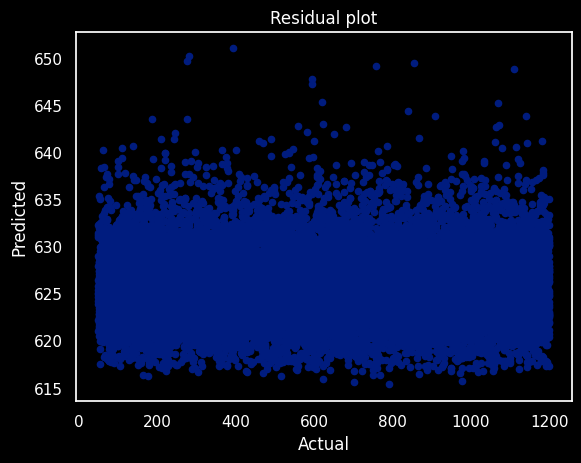

In [ ]:
model = LinearRegression()

comment = "Applied robust scaler, train test split 20%, stratify by y"

model, l_model_metrics, l_model_time = evaluate_model(model,
                                                        x_train, y_train,
                                                        x_test, y_test,
                                                        "linear_reg_1",
                                                        comment
                                                        )

### 2. Decision Tree Regressor

Model Performance Metrics (test data):
MSE: 176145.3247537236
RMSE: 419.6967056741375
MAE: 307.3172310601629
R2: -0.6008449960239817


<Figure size 1500x800 with 0 Axes>

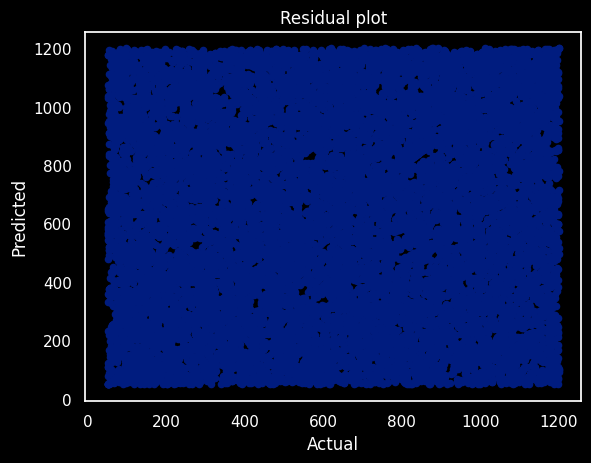

In [ ]:
model = DecisionTreeRegressor()

comment = 'Decision Tree with default settings, applied robust scaler to data, train/test 20%, stratified by price'

model, model_metrics, model_time = evaluate_model(model,
                                                      x_train, y_train,
                                                      x_test, y_test,
                                                      "Decision_Tree_1",
                                                      comment
                                                      )

### 3. RandomForest Regressor

Model Performance Metrics (test data):
MSE: 96234.77465068939
RMSE: 310.2173023070915
MAE: 257.67587055649153
R2: 0.1253985443074046


<Figure size 1500x800 with 0 Axes>

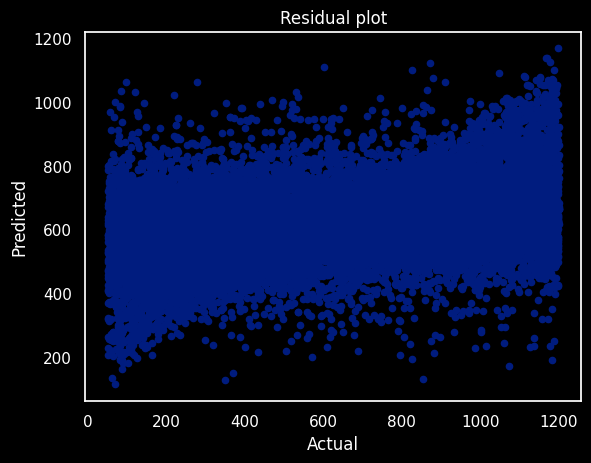

In [ ]:
model = RandomForestRegressor()

comment = 'Random Forest with default settings, applied robust scaler to data, train/test 20%, stratified by price'

model, model_metrics, model_time = evaluate_model(model,
                                                      x_train, y_train,
                                                      x_test, y_test,
                                                      "Random_Forest_1",
                                                      comment
                                                      )

In [ ]:
read_modeling_results()

,id,MSE,MAE,RMSE,R2,train_time,train_timestamp,model_path,comment
Unnamed: 0,,,,,,,,,
NaN,linear_reg_1,110029.892027,286.889695,331.707540,0.000026,0.055741,2024-04-03 11:25:49,/content/models/linear_reg_1.h5,"Applied robust scaler, train test split 20%, s..."
NaN,Decision_Tree_1,176145.324754,307.317231,419.696706,-0.600845,0.487914,2024-04-03 11:25:50,/content/models/Decision_Tree_1.h5,"Decision Tree with default settings, applied r..."
NaN,Random_Forest_1,96234.774651,257.675871,310.217302,0.125399,30.567883,2024-04-03 11:26:22,/content/models/Random_Forest_1.h5,"Random Forest with default settings, applied r..."


## Advanced Modeling

### Feature Selection

In [ ]:
data_fs = data.copy()

In [ ]:
data_fs.drop(['neighbourhood', 'service_fee', 'last_review'], axis=1, inplace=True)

In [ ]:
# Create a dictionary to store the label encoders for each column
label_encoders = {}

# Iterate over the columns of the dataframe
for column in data_fs.select_dtypes(include=['category', 'object']):
    # Create a label encoder for the column
    le = LabelEncoder()
    # Fit the label encoder on the column and transform the values
    data_fs[column] = le.fit_transform(data_fs[column])
    # Store the label encoder in the dictionary
    label_encoders[column] = le

In [ ]:
data_fs.dtypes

host_identity_verified              int64
neighbourhood_group                 int64
instant_bookable                    int64
cancellation_policy                 int64
room_type                           int64
construction_year                 float64
price                             float64
minimum_nights                    float64
number_of_reviews                 float64
reviews_per_month                 float64
review_rate_number                float64
calculated_host_listings_count    float64
availability_365                  float64
availability_grp                    int64
minimum_nights_bins                 int64
listings_count_bins                 int64
dtype: object

In [ ]:
data_fs = data_fs.astype(float)

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, ExtraTreesRegressor
from sklearn.impute import SimpleImputer

In [ ]:
# Split the dataset into features (Xfs) and target (yfs)
Xfs = data_fs.drop(['price'], axis=1)  # Features
yfs = data_fs['price']  # Target variable

# Split the dataset into a training set and a test set
X_trainfs, X_testfs, y_trainfs, y_testfs = train_test_split(Xfs, yfs, test_size=0.2, random_state=42)

# Initialize the imputer and RandomForestRegressor
imputer = SimpleImputer(strategy='median')
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Impute missing values in the training and test sets
X_trainfs_imputed = imputer.fit_transform(X_trainfs)
X_testfs_imputed = imputer.transform(X_testfs)

# Fit the model on the training data
rf.fit(X_trainfs_imputed, y_trainfs)

# Get the feature importances
rf_importances = rf.feature_importances_

# Create a DataFrame to hold the feature importances
features_fs = pd.DataFrame({
    'Feature': X_trainfs.columns,
    'Random Forest Importance': rf_importances
})

# Sort the DataFrame by importance
features_fs.sort_values(by='Random Forest Importance', ascending=False, inplace=True)

# Display the feature importances
print(features_fs)

                           Feature  Random Forest Importance
11                availability_365                  0.191087
7                number_of_reviews                  0.181223
5                construction_year                  0.144378
6                   minimum_nights                  0.081600
9               review_rate_number                  0.079468
10  calculated_host_listings_count                  0.052205
1              neighbourhood_group                  0.051671
8                reviews_per_month                  0.047882
3              cancellation_policy                  0.046863
4                        room_type                  0.032388
0           host_identity_verified                  0.027617
2                 instant_bookable                  0.026275
14             listings_count_bins                  0.018319
13             minimum_nights_bins                  0.010954
12                availability_grp                  0.008070


In [ ]:
imputer = SimpleImputer(strategy='median')
et = ExtraTreesRegressor(n_estimators=100, random_state=42)

# Impute missing values in the training and test sets
X_trainfs_imputed = imputer.fit_transform(X_trainfs)
X_testfs_imputed = imputer.transform(X_testfs)

# Fit the model on the training data
et.fit(X_trainfs_imputed, y_trainfs)

# Get the feature importances
et_importances = et.feature_importances_

# Create a DataFrame to hold the feature importances
featuresfs = pd.DataFrame({
    'Feature': X_trainfs.columns,
    'Extra Trees Importance': et_importances
})

# Sort the DataFrame by importance
featuresfs.sort_values(by='Extra Trees Importance', ascending=False, inplace=True)

# Display the feature importances
print(featuresfs)


                           Feature  Extra Trees Importance
7                number_of_reviews                0.160739
5                construction_year                0.144001
11                availability_365                0.129607
6                   minimum_nights                0.103914
9               review_rate_number                0.065970
8                reviews_per_month                0.063220
1              neighbourhood_group                0.058677
3              cancellation_policy                0.058648
10  calculated_host_listings_count                0.046037
0           host_identity_verified                0.032022
12                availability_grp                0.031149
2                 instant_bookable                0.029591
4                        room_type                0.028141
14             listings_count_bins                0.028000
13             minimum_nights_bins                0.020282


The top 5 features considering both results are:
- availability_365
- number_of_reviews
- construction_year
- minimum_nights

In [ ]:
training_features_fs = ["price", "availability_365", "number_of_reviews", "construction_year", "minimum_nights"]

In [ ]:
data_train_fs = data_fs[training_features_fs].copy()

In [ ]:
data_train_fs.dropna(inplace = True)

In [ ]:
x_fs = data_train_fs.drop(["price"], axis=1)
y_fs = data_train_fs["price"]

x_train_fs, x_test_fs, y_train_fs, y_test_fs = train_test_split(x_fs, y_fs, test_size=0.2, random_state=42, stratify=y_fs)

robust_scaler = RobustScaler()
x_train_scaled = robust_scaler.fit_transform(x_train_fs)
x_test_scaled = robust_scaler.transform(x_test_fs)

Model Performance Metrics (test data):
MSE: 110059.01215370206
RMSE: 331.75143127604144
MAE: 286.9812426058645
R2: 0.000103738717765256


<Figure size 1500x800 with 0 Axes>

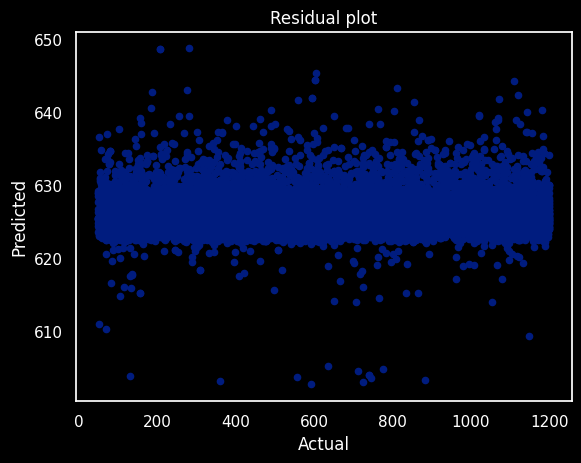

In [ ]:
model = LinearRegression()

comment = "Applied robust scaler, train test split 20%, stratify by y"

model, l_model_metrics, l_model_time = evaluate_model(model,
                                                      x_train_scaled, y_train_fs,
                                                      x_test_scaled, y_test_fs,
                                                      "linear_reg_2",
                                                      comment
                                                      )

Model Performance Metrics (test data):
MSE: 131781.85562367042
RMSE: 363.0177070387482
MAE: 241.96349254598158
R2: -0.19725029476844158


<Figure size 1500x800 with 0 Axes>

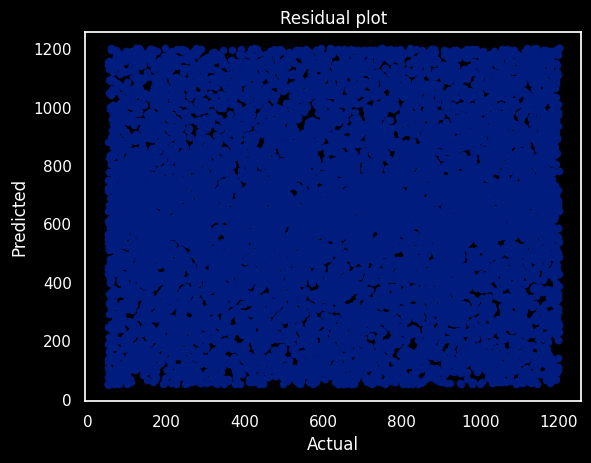

In [ ]:
model = DecisionTreeRegressor()

comment = 'Decision Tree with default settings, applied robust scaler to data, train/test 20%, stratified by price'

model, model_metrics, model_time = evaluate_model(model,
                                                  x_train_scaled, y_train_fs,
                                                  x_test_scaled, y_test_fs,
                                                  "Decision_Tree_2",
                                                  comment
                                                  )

Model Performance Metrics (test data):
MSE: 86643.6127418711
RMSE: 294.3528711289752
MAE: 227.50080357113092
R2: 0.21283479881144318


<Figure size 1500x800 with 0 Axes>

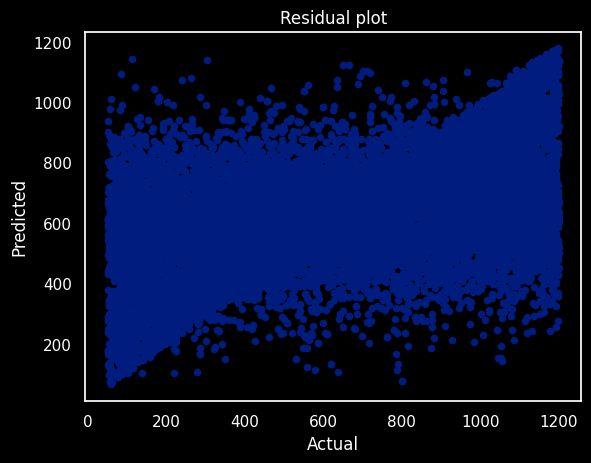

In [ ]:
model = RandomForestRegressor()

comment = 'Random Forest with default settings, applied robust scaler to data, train/test 20%, stratified by price'

model, model_metrics, model_time = evaluate_model(model,
                                                  x_train_scaled, y_train_fs,
                                                  x_test_scaled, y_test_fs,
                                                  "Random_Forest_3",
                                                  comment
                                                  )

In [ ]:
read_modeling_results()

,id,MSE,MAE,RMSE,R2,train_time,train_timestamp,model_path,comment
Unnamed: 0,,,,,,,,,
NaN,linear_reg_1,110029.892027,286.889695,331.707540,0.000026,0.055741,2024-04-03 11:25:49,/content/models/linear_reg_1.h5,"Applied robust scaler, train test split 20%, s..."
NaN,Decision_Tree_1,176145.324754,307.317231,419.696706,-0.600845,0.487914,2024-04-03 11:25:50,/content/models/Decision_Tree_1.h5,"Decision Tree with default settings, applied r..."
NaN,Random_Forest_1,96234.774651,257.675871,310.217302,0.125399,30.567883,2024-04-03 11:26:22,/content/models/Random_Forest_1.h5,"Random Forest with default settings, applied r..."
NaN,linear_reg_1,110059.012154,286.981243,331.751431,0.000104,0.025096,2024-04-03 11:38:39,/content/models/linear_reg_1.h5,"Applied robust scaler, train test split 20%, s..."
NaN,Decision_Tree_1,131781.855624,241.963493,363.017707,-0.197250,0.272478,2024-04-03 11:38:49,/content/models/Decision_Tree_1.h5,"Decision Tree with default settings, applied r..."
NaN,Random_Forest_3,86643.612742,227.500804,294.352871,0.212835,19.754039,2024-04-03 11:40:53,/content/models/Random_Forest_3.h5,"Random Forest with default settings, applied r..."
